# Assessing childhood obesity through geospatial placement of fast food restaurants

## *A Coursera Applied Data Science Capstone project notebook* 

The main data set that will be used is the London Borough Profiles and the London Borough Atlas from the London Datastore (www.data.london.gov.uk). These two files are available in Excel format and they will provide data on prevalence of childhood obesity in each of the boroughs.



We first install and import all the relevant libraries and packages for the data analysis.

In [1]:
import numpy as np      # to handle data in a vectorized manner
import statistics       # for statistical analysis
from scipy import stats
from sklearn import preprocessing

import pandas as pd     # for data analsysis and dataframes
pd.set_option('display.max_columns', None)  # to enable maximum column display
pd.set_option('display.max_rows', None)     # to enable maximum row display

import json # library to handle JSON files

!conda install -c conda-forge geopy --yes 
from geopy.geocoders import Nominatim # to convert an address into latitude and longitude values
import pgeocode # to convert postcodes into coordinates
import geopy.distance # to calculate distance between coordinates

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
%matplotlib inline


!conda install -c conda-forge folium=0.5.0 --yes 
import folium  # map rendering library

import warnings; warnings.simplefilter('ignore')

print('Libraries imported.')

Solving environment: ...working... done

# All requested packages already installed.

Solving environment: ...working... done

# All requested packages already installed.

Libraries imported.


First, we download the London Borough Profile data sheet from (https://data.london.gov.uk/dataset/london-borough-profiles) and save it to a temporary dataframe. 

In [2]:
temp_data = pd.read_excel("https://data.london.gov.uk/download/london-borough-profiles/80647ce7-14f3-4e31-b1cd-d5f7ea3553be/london-borough-profiles.xlsx", sheet_name="Data")

In [3]:
# We check the entire data sheet to see which rows are of use to us. 
temp_data 

,Code,New code,Area name,Inner/ Outer London,GLA Population Estimate 2017,GLA Household Estimate 2017,Inland Area (Hectares),Population density (per hectare) 2017,"Average Age, 2017","Proportion of population aged 0-15, 2015","Proportion of population of working-age, 2015","Proportion of population aged 65 and over, 2015",Net internal migration (2015),Net international migration (2015),Net natural change (2015),% of resident population born abroad (2015),Largest migrant population by country of birth (2011),% of largest migrant population (2011),Second largest migrant population by country of birth (2011),% of second largest migrant population (2011),Third largest migrant population by country of birth (2011),% of third largest migrant population (2011),% of population from BAME groups (2016),% people aged 3+ whose main language is not English (2011 Census),"Overseas nationals entering the UK (NINo), (2015/16)","New migrant (NINo) rates, (2015/16)",Largest migrant population arrived during 2015/16,Second largest migrant population arrived during 2015/16,Third largest migrant population arrived during 2015/16,Employment rate (%) (2015),Male employment rate (2015),Female employment rate (2015),Unemployment rate (2015),Youth Unemployment (claimant) rate 18-24 (Dec-15),Proportion of 16-18 year olds who are NEET (%) (2014),Proportion of the working-age population who claim out-of-work benefits (%) (May-2016),% working-age with a disability (2015),Proportion of working age people with no qualifications (%) 2015,Proportion of working age with degree or equivalent and above (%) 2015,"Gross Annual Pay, (2016)",Gross Annual Pay - Male (2016),Gross Annual Pay - Female (2016),Modelled Household median income estimates 2012/13,% adults that volunteered in past 12 months (2010/11 to 2012/13),Number of jobs by workplace (2014),% of employment that is in public sector (2014),"Jobs Density, 2015","Number of active businesses, 2015",Two-year business survival rates (started in 2013),Crime rates per thousand population 2014/15,Fires per thousand population (2014),Ambulance incidents per hundred population (2014),"Median House Price, 2015","Average Band D Council Tax charge (£), 2015/16",New Homes (net) 2015/16 (provisional),"Homes Owned outright, (2014) %","Being bought with mortgage or loan, (2014) %","Rented from Local Authority or Housing Association, (2014) %","Rented from Private landlord, (2014) %","% of area that is Greenspace, 2005",Total carbon emissions (2014),"Household Waste Recycling Rate, 2014/15","Number of cars, (2011 Census)","Number of cars per household, (2011 Census)","% of adults who cycle at least once per month, 2014/15","Average Public Transport Accessibility score, 2014","Achievement of 5 or more A*- C grades at GCSE or equivalent including English and Maths, 2013/14",Rates of Children Looked After (2016),% of pupils whose first language is not English (2015),% children living in out-of-work households (2015),"Male life expectancy, (2012-14)","Female life expectancy, (2012-14)",Teenage conception rate (2014),Life satisfaction score 2011-14 (out of 10),Worthwhileness score 2011-14 (out of 10),Happiness score 2011-14 (out of 10),Anxiety score 2011-14 (out of 10),Childhood Obesity Prevalance (%) 2015/16,People aged 17+ with diabetes (%),Mortality rate from causes considered preventable 2012/14,Political control in council,Proportion of seats won by Conservatives in 2014 election,Proportion of seats won by Labour in 2014 election,Proportion of seats won by Lib Dems in 2014 election,Turnout at 2014 local elections
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,E09000001,E09000001,City of London,Inner London,8800.0,5325.82,290.393,30.3037

We are interested only in the 32 Boroughs of London (from index = 2 to index = 33; City of London is not a borough) so we only keep those and save them into a new dataframe

In [4]:
borough_data = temp_data.loc[2:33, ]
borough_data.reset_index(inplace=True, drop=True)
borough_data

,Code,New code,Area name,Inner/ Outer London,GLA Population Estimate 2017,GLA Household Estimate 2017,Inland Area (Hectares),Population density (per hectare) 2017,"Average Age, 2017","Proportion of population aged 0-15, 2015","Proportion of population of working-age, 2015","Proportion of population aged 65 and over, 2015",Net internal migration (2015),Net international migration (2015),Net natural change (2015),% of resident population born abroad (2015),Largest migrant population by country of birth (2011),% of largest migrant population (2011),Second largest migrant population by country of birth (2011),% of second largest migrant population (2011),Third largest migrant population by country of birth (2011),% of third largest migrant population (2011),% of population from BAME groups (2016),% people aged 3+ whose main language is not English (2011 Census),"Overseas nationals entering the UK (NINo), (2015/16)","New migrant (NINo) rates, (2015/16)",Largest migrant population arrived during 2015/16,Second largest migrant population arrived during 2015/16,Third largest migrant population arrived during 2015/16,Employment rate (%) (2015),Male employment rate (2015),Female employment rate (2015),Unemployment rate (2015),Youth Unemployment (claimant) rate 18-24 (Dec-15),Proportion of 16-18 year olds who are NEET (%) (2014),Proportion of the working-age population who claim out-of-work benefits (%) (May-2016),% working-age with a disability (2015),Proportion of working age people with no qualifications (%) 2015,Proportion of working age with degree or equivalent and above (%) 2015,"Gross Annual Pay, (2016)",Gross Annual Pay - Male (2016),Gross Annual Pay - Female (2016),Modelled Household median income estimates 2012/13,% adults that volunteered in past 12 months (2010/11 to 2012/13),Number of jobs by workplace (2014),% of employment that is in public sector (2014),"Jobs Density, 2015","Number of active businesses, 2015",Two-year business survival rates (started in 2013),Crime rates per thousand population 2014/15,Fires per thousand population (2014),Ambulance incidents per hundred population (2014),"Median House Price, 2015","Average Band D Council Tax charge (£), 2015/16",New Homes (net) 2015/16 (provisional),"Homes Owned outright, (2014) %","Being bought with mortgage or loan, (2014) %","Rented from Local Authority or Housing Association, (2014) %","Rented from Private landlord, (2014) %","% of area that is Greenspace, 2005",Total carbon emissions (2014),"Household Waste Recycling Rate, 2014/15","Number of cars, (2011 Census)","Number of cars per household, (2011 Census)","% of adults who cycle at least once per month, 2014/15","Average Public Transport Accessibility score, 2014","Achievement of 5 or more A*- C grades at GCSE or equivalent including English and Maths, 2013/14",Rates of Children Looked After (2016),% of pupils whose first language is not English (2015),% children living in out-of-work households (2015),"Male life expectancy, (2012-14)","Female life expectancy, (2012-14)",Teenage conception rate (2014),Life satisfaction score 2011-14 (out of 10),Worthwhileness score 2011-14 (out of 10),Happiness score 2011-14 (out of 10),Anxiety score 2011-14 (out of 10),Childhood Obesity Prevalance (%) 2015/16,People aged 17+ with diabetes (%),Mortality rate from causes considered preventable 2012/14,Political control in council,Proportion of seats won by Conservatives in 2014 election,Proportion of seats won by Labour in 2014 election,Proportion of seats won by Lib Dems in 2014 election,Turnout at 2014 local elections
0,E09000002,E09000002,Barking and Dagenham,Outer London,209000.0,78188.4,3610.78,57.8822,32.9,27.2,63.1,9.7,-1176,2509,2356,37.8,Nigeria,4.67697,India,2.34736,Pakistan,2.33284,49.5318,18.7242,7538.0,59.139658,Romania,Bulgaria,Lithuania,65.8,75.6,56.5,11,4.49666,5.7,10.5287,17.2,11.3,32.2,27886,30104,24602,29420,20.5297,58900,21.104536,0.48,6560.0,73.0,83.3591,3.03015,13.6693,243500,1354.03,730,16.4379,27.3545,35.917

Since we are interested in the Childhood Obesity Prevalence rates only, we create a new dataframe with just the name of the borough and the corresponding childhood obesity prevalence rate.

In [5]:
obesity_data=borough_data[['Area name','Childhood Obesity Prevalance (%) 2015/16']]
obesity_data.rename(columns={'Area name':'Borough'}, inplace=True)
obesity_data

,Borough,Childhood Obesity Prevalance (%) 2015/16
0,Barking and Dagenham,28.542
1,Barnet,20.6579
2,Bexley,22.7093
3,Brent,24.3444
4,Bromley,15.9988
5,Camden,21.3267
6,Croydon,24.4814
7,Ealing,23.8228
8,Enfield,25.1879
9,Greenwich,27.7255


For each borough, we will consider the 'centre' of the borough to be the location of the respective borough council (i.e. town hall). The postcode for each borough council has been found directly from the internet. 

In [6]:
# we first save all the postcodes into a list and then add it to the main dataframe.
council_postcode=['IG11 7LU', 'N11 1NP', 'DA6 7LB', 'HA9 0FJ', 'BR1 3UH', 'WC1H 9JE', 'CR0 1EA', 'W5 2HL', 'EN1 3XA', 'SE18 6PW', 'E8 1EA', 'W6 9JU', 'N22 8LE', 'HA1 2XY', 'RM1 3BD', 'UB8 1UW', 'TW3 4DN', 'N1 2UD', 'W8 7NX', 'KT1 1EU', 'SW2 1RW', 'SE6 4RU', 'SM4 5DX', 'E16 2QU', 'IG1 1DD', 'TW1 3BZ', 'SE1 2QH', 'SM1 1EA', 'E14 2BG', 'E17 4JF', 'SW18 2PU', 'SW1E 6QP']
obesity_data['Post Code']=council_postcode
obesity_data.head()

,Borough,Childhood Obesity Prevalance (%) 2015/16,Post Code
0,Barking and Dagenham,28.542,IG11 7LU
1,Barnet,20.6579,N11 1NP
2,Bexley,22.7093,DA6 7LB
3,Brent,24.3444,HA9 0FJ
4,Bromley,15.9988,BR1 3UH


Next, we use pgeocode to extract the coordinates for each post code from the above dataframe and store it in the same dataframe.

In [7]:
coord=[]
longlist=[]
latlist=[]
nomi = pgeocode.Nominatim("GB") # Selecting Great Britain as the country. 

for i in obesity_data.index:
    coord=nomi.query_postal_code(obesity_data.iloc[i]['Post Code'])
    latlist.append(coord['latitude'])
    longlist.append(coord['longitude'])
obesity_data['Latitude']=latlist
obesity_data['Longitude']=longlist
obesity_data_test=obesity_data
obesity_data.head()

,Borough,Childhood Obesity Prevalance (%) 2015/16,Post Code,Latitude,Longitude
0,Barking and Dagenham,28.542,IG11 7LU,51.5333,0.0833
1,Barnet,20.6579,N11 1NP,51.6197,-0.1441
2,Bexley,22.7093,DA6 7LB,51.4629,0.1394
3,Brent,24.3444,HA9 0FJ,51.5531,-0.3023
4,Bromley,15.9988,BR1 3UH,51.4013,0.0305


We draw a bar chart to compare the prevalence of childhood obesity in the London boroughs.

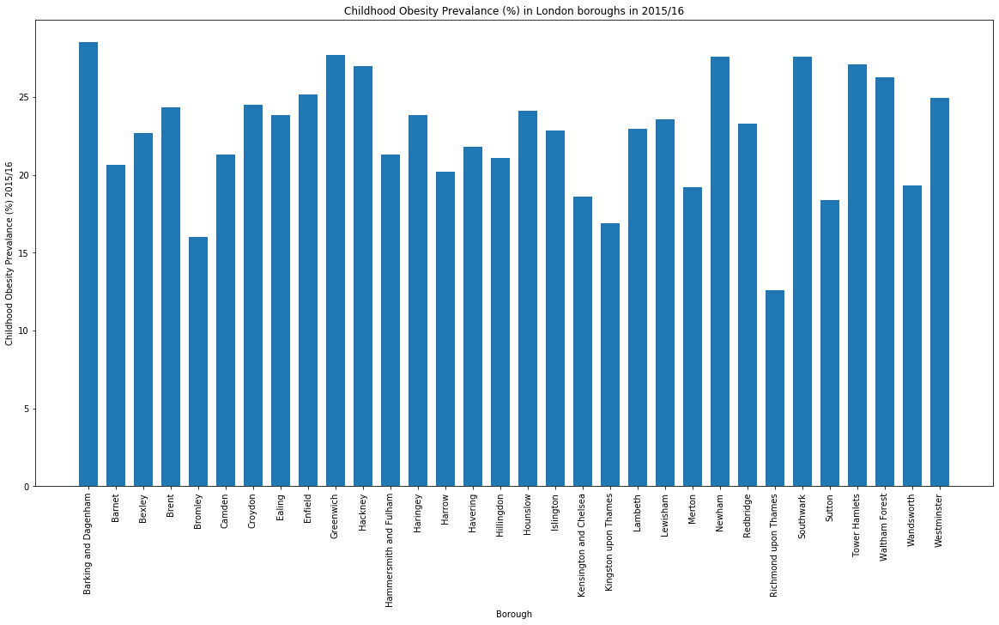

In [8]:

barx=obesity_data['Borough'].tolist()
bary=obesity_data['Childhood Obesity Prevalance (%) 2015/16'].tolist()

plt.figure(figsize=(20,10))

plt.bar(barx, bary, width=0.7)
plt.xlabel("Borough")
plt.ylabel("Childhood Obesity Prevalance (%) 2015/16")
plt.title("Childhood Obesity Prevalance (%) in London boroughs in 2015/16")

plt.xticks(barx, rotation='vertical')

plt.show()


To automate the process of finding the schools and the fast food restaurants near each school, we will build a function and use it to loop through each of the boroughs.

In [9]:

def mainfunction(a):   # define the main function
    def averageoflist(l): # defining an averaging function that will be used later to calculate the mean.
        if len(l)!= 0:
            avg = sum(l) / len(l) 
            return avg
        else: 
            pass 
    global distance_temp2 # defining global variables for this function
    global distance_temp3
    global number_temp1
    global number_temp2

    CLIENT_ID = 'MCMTGF531L4XZSY1RMW4SDR5THRMBQQ55YDDMWJCMLTDJTHY' # Foursquare ID
    CLIENT_SECRET = 'UDDUEE34YHXZYTYK5WNH2IBJTNI40HROYX1FE5P4GYXY5SYI' # Foursquare Secret
    VERSION = '20200617' # Foursquare API version
    LIMIT1 = 10 # limit for the number of schools returned
    radius1 = 2000 # radius for the schools 
    LIMIT2 = 50 # limit for the number of fast food restaurants returned
    radius2 = 1000 # radius for the fast food restaurants
    categoryid_school='4bf58dd8d48988d13b941735'     # search category ID for schools
    categoryid_ffr= '4bf58dd8d48988d16e941735'       # search category ID for fast food restaurants
    
    
    # We next define the url that will be used to get the results
    url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    obesity_data.loc[a][3], 
    obesity_data.loc[a][4], 
    radius1, 
    LIMIT1, categoryid_school)
    
    results = requests.get(url).json()
    schools = results['response']['venues']
    nearby_schools = json_normalize(schools) # flatten JSON
    
    count1=0  # these are the two counters that are used to keep count of the number of schools and fast food restaurants
    count2=0
    
    for j in nearby_schools.index:                     # the first for loop that will search for the restaurants
            nearby_schools.iloc[j]['location.lat']
            nearby_schools.iloc[j]['location.lng']

            # the second url will be used to return results for fast food restaurants
            url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            nearby_schools.iloc[j]['location.lat'], 
            nearby_schools.iloc[j]['location.lng'], 
            radius2, 
            LIMIT2, categoryid_ffr)
            url 
            
            results_ffr = requests.get(url).json()
            ffr = results_ffr['response']['venues']
            nearby_ffr = json_normalize(ffr) # flatten JSON
            
            distance_temp1=[]                # defining an empty list that will be used to store the distances
            
            count2+=1                       # second counter
            
            
            # second for loop used to loop through each restaurant and measure the distance from the respective school
            
            for k in nearby_ffr.index:      

                    nearby_ffr.iloc[k]['location.lat']
                    nearby_ffr.iloc[k]['location.lng']

                    coords_1 = (nearby_ffr.iloc[k]['location.lat'], nearby_ffr.iloc[k]['location.lng']) # location of the restaurant
                    coords_2 = (nearby_schools.iloc[j]['location.lat'], nearby_schools.iloc[j]['location.lng']) # location of the school
                    distance_temp1.append(geopy.distance.vincenty(coords_1, coords_2).km) # Vincenty method of calculating distance between the two points
                    print("Borough:", obesity_data.loc[a][0], "School:", nearby_schools.iloc[j]['name'], "Fast food restaurant:", nearby_ffr.iloc[k]['name'])
                    count1+=1
                    print(distance_temp1)
                    
            print("Average distance of all restaurants from",nearby_schools.iloc[j]['name'], ":",averageoflist(distance_temp1)) 
            
            distance_temp2=distance_temp2+distance_temp1 # adding the mean distance to a list containing all the mean distances from the particular school
    print("Average distance of restaurants from schools in ",obesity_data.loc[a][0], ":",averageoflist(distance_temp2))
    distance_temp3.append(averageoflist(distance_temp2)) # adding all the mean distances to a list containing all the mean distances within a borough
    number_temp1.append(count1)
    number_temp2.append(count2)

In [10]:
# next, we run the function using a for loop through the main dataframe. 

number_temp1=[]
number_temp2=[]
distance_temp2=[]
distance_temp3=[]
distance_temp4=[]

for i in obesity_data.index: 
    mainfunction(i)
 

Borough: Barking and Dagenham School: Eastbury Comprehensive School Fast food restaurant: KFC
[0.6719314076914298]
Borough: Barking and Dagenham School: Eastbury Comprehensive School Fast food restaurant: Subway
[0.6719314076914298, 0.6975750879824091]
Borough: Barking and Dagenham School: Eastbury Comprehensive School Fast food restaurant: McDonald's
[0.6719314076914298, 0.6975750879824091, 0.9010050853247621]
Borough: Barking and Dagenham School: Eastbury Comprehensive School Fast food restaurant: APR Chicken & Pizza
[0.6719314076914298, 0.6975750879824091, 0.9010050853247621, 0.8102793795332225]
Borough: Barking and Dagenham School: Eastbury Comprehensive School Fast food restaurant: The Chubby Friar
[0.6719314076914298, 0.6975750879824091, 0.9010050853247621, 0.8102793795332225, 0.5441062704255776]
Borough: Barking and Dagenham School: Eastbury Comprehensive School Fast food restaurant: Griller
[0.6719314076914298, 0.6975750879824091, 0.9010050853247621, 0.8102793795332225, 0.54410

Borough: Barnet School: Bright Horizons Southgate Day Nursery and Preschool Fast food restaurant: McDonald's
[0.08732944142779829]
Borough: Barnet School: Bright Horizons Southgate Day Nursery and Preschool Fast food restaurant: Subway
[0.08732944142779829, 0.06486498354666508]
Borough: Barnet School: Bright Horizons Southgate Day Nursery and Preschool Fast food restaurant: KFC
[0.08732944142779829, 0.06486498354666508, 0.10781890656897973]
Borough: Barnet School: Bright Horizons Southgate Day Nursery and Preschool Fast food restaurant: The Charcoal Grill
[0.08732944142779829, 0.06486498354666508, 0.10781890656897973, 0.10134335487501331]
Average distance of all restaurants from Bright Horizons Southgate Day Nursery and Preschool : 0.0903391716046141
Borough: Barnet School: Northside Primary School Fast food restaurant: McDonald's
[0.013872924567221062]
Borough: Barnet School: Northside Primary School Fast food restaurant: KFC
[0.013872924567221062, 0.01773734573986919]
Borough: Barnet

Borough: Bexley School: Just Learning Nursery Fast food restaurant: Burger King
[0.4492894292234617]
Borough: Bexley School: Just Learning Nursery Fast food restaurant: McDonald's
[0.4492894292234617, 0.5390740653089883]
Borough: Bexley School: Just Learning Nursery Fast food restaurant: Subway
[0.4492894292234617, 0.5390740653089883, 0.4024733440429866]
Borough: Bexley School: Just Learning Nursery Fast food restaurant: Silver Spoon Cafe & Restaurant
[0.4492894292234617, 0.5390740653089883, 0.4024733440429866, 0.5386328854798949]
Borough: Bexley School: Just Learning Nursery Fast food restaurant: Kebabies
[0.4492894292234617, 0.5390740653089883, 0.4024733440429866, 0.5386328854798949, 0.8481144496612502]
Borough: Bexley School: Just Learning Nursery Fast food restaurant: KFC
[0.4492894292234617, 0.5390740653089883, 0.4024733440429866, 0.5386328854798949, 0.8481144496612502, 0.3498877116061545]
Borough: Bexley School: Just Learning Nursery Fast food restaurant: Bexley Chicken Palace
[0

Borough: Brent School: Harrow School Speach Room Fast food restaurant: Subway
[0.6703816013559705]
Borough: Brent School: Harrow School Speach Room Fast food restaurant: Subway
[0.6703816013559705, 0.9447743661021315]
Borough: Brent School: Harrow School Speach Room Fast food restaurant: Subway
[0.6703816013559705, 0.9447743661021315, 0.8416590258805767]
Borough: Brent School: Harrow School Speach Room Fast food restaurant: Subway
[0.6703816013559705, 0.9447743661021315, 0.8416590258805767, 1.0774313312453327]
Borough: Brent School: Harrow School Speach Room Fast food restaurant: McDonald's
[0.6703816013559705, 0.9447743661021315, 0.8416590258805767, 1.0774313312453327, 1.0863607940157987]
Borough: Brent School: Harrow School Speach Room Fast food restaurant: New Royal Chicken
[0.6703816013559705, 0.9447743661021315, 0.8416590258805767, 1.0774313312453327, 1.0863607940157987, 1.151277403644926]
Borough: Brent School: Harrow School Speach Room Fast food restaurant: American Hot n Spicy 

Borough: Brent School: Staffroom Preston Manor Fast food restaurant: Subway
[0.6604392388113859]
Borough: Brent School: Staffroom Preston Manor Fast food restaurant: Subway
[0.6604392388113859, 0.9914228290961351]
Borough: Brent School: Staffroom Preston Manor Fast food restaurant: Subway
[0.6604392388113859, 0.9914228290961351, 0.7889748007065718]
Borough: Brent School: Staffroom Preston Manor Fast food restaurant: Subway
[0.6604392388113859, 0.9914228290961351, 0.7889748007065718, 1.1103896088848366]
Borough: Brent School: Staffroom Preston Manor Fast food restaurant: McDonald's
[0.6604392388113859, 0.9914228290961351, 0.7889748007065718, 1.1103896088848366, 0.7297075869950308]
Borough: Brent School: Staffroom Preston Manor Fast food restaurant: Preston Kebab House
[0.6604392388113859, 0.9914228290961351, 0.7889748007065718, 1.1103896088848366, 0.7297075869950308, 0.840149154929496]
Borough: Brent School: Staffroom Preston Manor Fast food restaurant: Roosters Piri Piri
[0.66043923881

Borough: Bromley School: Valley Primary School Fast food restaurant: McDonald's
[0.6404838088464804]
Borough: Bromley School: Valley Primary School Fast food restaurant: McDonald's
[0.6404838088464804, 0.8597305560197425]
Borough: Bromley School: Valley Primary School Fast food restaurant: Burger King
[0.6404838088464804, 0.8597305560197425, 0.7664736944826234]
Borough: Bromley School: Valley Primary School Fast food restaurant: Subway
[0.6404838088464804, 0.8597305560197425, 0.7664736944826234, 0.8003911755604755]
Borough: Bromley School: Valley Primary School Fast food restaurant: Seven Stars Takeaway
[0.6404838088464804, 0.8597305560197425, 0.7664736944826234, 0.8003911755604755, 0.39280460213165086]
Borough: Bromley School: Valley Primary School Fast food restaurant: Subway
[0.6404838088464804, 0.8597305560197425, 0.7664736944826234, 0.8003911755604755, 0.39280460213165086, 1.086632366048832]
Borough: Bromley School: Valley Primary School Fast food restaurant: Five Guys
[0.64048380

Borough: Camden School: West End Stage Fast food restaurant: McDonald's
[0.05991868858843221, 0.20976257352895755, 0.30698720029706494, 1.0017294054307497, 1.07117432210903, 1.047165996448615, 0.8558365779364341, 0.49169174954510764, 0.6451435182002763, 0.35877507281430665, 0.6518915896231126, 0.2384494282429787, 0.3670669728519737, 0.27089543324605014, 0.511269534009325, 0.9167222943652528, 0.9550813780064019, 1.0469177125814653, 0.9116409891700783, 1.1414714478796912, 0.2587330060147857, 0.783838690892739, 0.9468702019119541, 0.8562882055644532, 1.3068866126249614, 0.562413416991153, 0.5472679696948993, 1.0566533890440974, 0.5425010491082115, 1.0441462156806403, 1.0774571037114997, 0.6707064015405135, 1.1049289107630798, 0.9946340678009026, 1.1347541240353827]
Borough: Camden School: West End Stage Fast food restaurant: Leon
[0.05991868858843221, 0.20976257352895755, 0.30698720029706494, 1.0017294054307497, 1.07117432210903, 1.047165996448615, 0.8558365779364341, 0.49169174954510764,

Borough: Camden School: St Paul's Cathedral School Fast food restaurant: Leon
[0.07519313969952436]
Borough: Camden School: St Paul's Cathedral School Fast food restaurant: Wasabi
[0.07519313969952436, 0.15830652403187123]
Borough: Camden School: St Paul's Cathedral School Fast food restaurant: Five Guys
[0.07519313969952436, 0.15830652403187123, 0.2545924229133339]
Borough: Camden School: St Paul's Cathedral School Fast food restaurant: Leon
[0.07519313969952436, 0.15830652403187123, 0.2545924229133339, 0.9316891406566727]
Borough: Camden School: St Paul's Cathedral School Fast food restaurant: Subway
[0.07519313969952436, 0.15830652403187123, 0.2545924229133339, 0.9316891406566727, 1.1306239977608463]
Borough: Camden School: St Paul's Cathedral School Fast food restaurant: Subway
[0.07519313969952436, 0.15830652403187123, 0.2545924229133339, 0.9316891406566727, 1.1306239977608463, 0.6794050519443627]
Borough: Camden School: St Paul's Cathedral School Fast food restaurant: Gallery Caf

Borough: Camden School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: Leon
[0.47194694729843556]
Borough: Camden School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: Subway
[0.47194694729843556, 0.7306922654640117]
Borough: Camden School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: McDonald's
[0.47194694729843556, 0.7306922654640117, 0.7235091143439473]
Borough: Camden School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: Leon
[0.47194694729843556, 0.7306922654640117, 0.7235091143439473, 0.9207391569877713]
Borough: Camden School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: McDonald's
[0.47194694729843556, 0.7306922654640117, 0.7235091143439473, 0.9207391569877713, 1.0540399093391029]
Borough: Camden School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: McDonald's
[0.47194694729843556, 0.7306922654640117, 0.7235091143439473, 0.9207391569877713, 1.0540399093391029

Borough: Camden School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: Gigs
[0.47194694729843556, 0.7306922654640117, 0.7235091143439473, 0.9207391569877713, 1.0540399093391029, 0.5605303713728712, 0.6314947542059646, 0.7262449254110216, 0.9298462317458036, 0.8383914328393909, 0.5603889473850806, 1.1023806376415757, 1.1186650709070798, 0.8578028892570853, 0.8703834671249774, 1.0690720306092134, 0.9642032001379965, 0.679906721962151, 0.9656971578040443, 0.5854923595905754, 0.6862353742972815, 0.8569848449479767, 0.7449560651596122, 0.8471123358159698, 0.7496539122206476, 1.2007630251425059, 0.6580422820714616, 0.9045806148347103, 0.6707565879857411, 0.641995946679176, 0.6667513817722663, 0.6516498389063025, 1.0389003610521983, 1.014682887635972, 0.9849140061923669, 0.6595434914111015]
Borough: Camden School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: Burgeri
[0.47194694729843556, 0.7306922654640117, 0.7235091143439473, 0.9207391569877713, 1.0540

Borough: Camden School: Argyle School Fast food restaurant: Burger King
[0.16673252285597742]
Borough: Camden School: Argyle School Fast food restaurant: McDonald's
[0.16673252285597742, 0.2393898998182819]
Borough: Camden School: Argyle School Fast food restaurant: Slim Chickens
[0.16673252285597742, 0.2393898998182819, 0.48339593546599047]
Borough: Camden School: Argyle School Fast food restaurant: McDonald's
[0.16673252285597742, 0.2393898998182819, 0.48339593546599047, 0.31334572001189753]
Borough: Camden School: Argyle School Fast food restaurant: Subway
[0.16673252285597742, 0.2393898998182819, 0.48339593546599047, 0.31334572001189753, 1.0051996270668273]
Borough: Camden School: Argyle School Fast food restaurant: Five Guys
[0.16673252285597742, 0.2393898998182819, 0.48339593546599047, 0.31334572001189753, 1.0051996270668273, 0.32454944332432045]
Borough: Camden School: Argyle School Fast food restaurant: Subway
[0.16673252285597742, 0.2393898998182819, 0.48339593546599047, 0.313

Borough: Camden School: Argyle School Fast food restaurant: Leon
[0.16673252285597742, 0.2393898998182819, 0.48339593546599047, 0.31334572001189753, 1.0051996270668273, 0.32454944332432045, 0.8164296136173322, 0.5343432501918928, 0.16977284873112072, 0.3525433916430861, 0.3150798753408148, 0.4168382916407859, 0.9649649911769381, 1.3522492896318052, 0.38343397192909556, 0.9514344075830183, 1.3784233008347295, 0.6154499182270735, 0.31078875560569713, 0.5679318215153449, 0.8883087233715026, 1.0409586397970223, 1.198910742480356, 0.2978037421058453, 1.0371709041136108, 0.626958985324531, 1.0437611805116431, 1.1166517667529074, 0.6145554248365668, 1.0512219354581727, 0.8693393359263472, 1.3539505961060911, 1.1204604612166527, 0.6741849833112827, 1.0376930497404588, 0.8836061320178631, 1.2463002022029062, 0.5271722630265453]
Borough: Camden School: Argyle School Fast food restaurant: West Cornwall Pasty Co
[0.16673252285597742, 0.2393898998182819, 0.48339593546599047, 0.31334572001189753, 1.

Borough: Camden School: Le Cordon Bleu Fast food restaurant: Subway
[0.18541692744813842, 0.5759922795214518, 0.8416208585819064, 0.24269415142287773, 0.21302278919962714, 0.7198108295549934, 1.0440911801705832, 0.5336966332397594, 0.7468574659515619, 0.4280215993849054, 0.4604466611410853, 0.8785713563063495, 0.7388550168795122, 0.55850803479314, 0.6785674009725849, 0.7589871032623499, 1.0607134196501178, 1.097544975242118, 0.9385087442659605, 1.1077761758641766, 0.7891617717832815, 1.0251110155486176, 0.5420019300781805, 0.3162542091087982, 1.1097612482678127, 1.1485884815203187, 0.6707069474444486, 1.064119188758095, 1.002901914051065, 0.4343621768033153, 1.2039389241983653, 0.9261203651407959, 0.9456822071540717, 0.984343944691466, 1.0165606898052284]
Borough: Camden School: Le Cordon Bleu Fast food restaurant: Leon
[0.18541692744813842, 0.5759922795214518, 0.8416208585819064, 0.24269415142287773, 0.21302278919962714, 0.7198108295549934, 1.0440911801705832, 0.5336966332397594, 0.74

Borough: Camden School: Working Mens College Fast food restaurant: KFC Mornington Crescent
[0.2772888398427121]
Borough: Camden School: Working Mens College Fast food restaurant: Subway
[0.2772888398427121, 0.6263895357922922]
Borough: Camden School: Working Mens College Fast food restaurant: Subway
[0.2772888398427121, 0.6263895357922922, 0.3760956787972142]
Borough: Camden School: Working Mens College Fast food restaurant: The Patate
[0.2772888398427121, 0.6263895357922922, 0.3760956787972142, 0.9860799281011662]
Borough: Camden School: Working Mens College Fast food restaurant: Subway
[0.2772888398427121, 0.6263895357922922, 0.3760956787972142, 0.9860799281011662, 0.8739821950622735]
Borough: Camden School: Working Mens College Fast food restaurant: Burger King
[0.2772888398427121, 0.6263895357922922, 0.3760956787972142, 0.9860799281011662, 0.8739821950622735, 1.020123878684868]
Borough: Camden School: Working Mens College Fast food restaurant: Chris's Fish Bar
[0.2772888398427121, 

Borough: Camden School: Language Studies International Fast food restaurant: Subway
[0.2085060140232673]
Borough: Camden School: Language Studies International Fast food restaurant: KFC
[0.2085060140232673, 0.18542366512813813]
Borough: Camden School: Language Studies International Fast food restaurant: Slim Chickens
[0.2085060140232673, 0.18542366512813813, 0.6645283847559574]
Borough: Camden School: Language Studies International Fast food restaurant: Leon
[0.2085060140232673, 0.18542366512813813, 0.6645283847559574, 0.8826594556539991]
Borough: Camden School: Language Studies International Fast food restaurant: Subway
[0.2085060140232673, 0.18542366512813813, 0.6645283847559574, 0.8826594556539991, 0.5693704198044829]
Borough: Camden School: Language Studies International Fast food restaurant: Leon
[0.2085060140232673, 0.18542366512813813, 0.6645283847559574, 0.8826594556539991, 0.5693704198044829, 0.28995424743942505]
Borough: Camden School: Language Studies International Fast food

Borough: Camden School: Language Studies International Fast food restaurant: Five Guys
[0.2085060140232673, 0.18542366512813813, 0.6645283847559574, 0.8826594556539991, 0.5693704198044829, 0.28995424743942505, 0.5039776163317328, 0.9374257230613909, 1.0849716549565078, 0.9132460456011718, 0.43164922609171624, 0.4329052976367856, 1.0074754268727129, 0.951117898300867, 0.6906260697835834, 0.6114895869927568, 1.103159127323881, 0.5911049822879123, 0.6069824392458404, 0.5300832748368615, 0.9030548019784651, 0.9021161385430982, 0.8235738249303777, 0.5759275533440065, 0.9359505741633414, 1.1057351344073465, 1.194758279758802, 0.9273437146097259, 0.35974679230960754, 1.0069155842617308, 0.7938397679960217, 1.123923143828202, 1.0305213977970231, 0.9220298498436612, 0.711810384291381, 1.0229062958074153, 0.6398927512670244, 0.835401014780116, 0.7886723597499953, 0.7795894280706555, 0.9348051636172345, 0.9470355809431033, 0.8730108663039802, 1.0666280193181588, 1.1369872457582928, 1.185013929325

Borough: Camden School: Pushkin House Fast food restaurant: Chicken Cottage
[0.1173891891436171]
Borough: Camden School: Pushkin House Fast food restaurant: Slim Chickens
[0.1173891891436171, 0.6355608471111306]
Borough: Camden School: Pushkin House Fast food restaurant: Subway
[0.1173891891436171, 0.6355608471111306, 0.35762861265596124]
Borough: Camden School: Pushkin House Fast food restaurant: Leon
[0.1173891891436171, 0.6355608471111306, 0.35762861265596124, 1.0799599276674365]
Borough: Camden School: Pushkin House Fast food restaurant: Subway
[0.1173891891436171, 0.6355608471111306, 0.35762861265596124, 1.0799599276674365, 0.8078923136441506]
Borough: Camden School: Pushkin House Fast food restaurant: Subway
[0.1173891891436171, 0.6355608471111306, 0.35762861265596124, 1.0799599276674365, 0.8078923136441506, 0.3033052795421532]
Borough: Camden School: Pushkin House Fast food restaurant: McDonald's
[0.1173891891436171, 0.6355608471111306, 0.35762861265596124, 1.0799599276674365, 0

Average distance of all restaurants from Quest Academy : None
Average distance of all restaurants from greenvale school : None
Borough: Croydon School: Kinderland Day Nursery Fast food restaurant: KFC
[0.8968600234255127]
Borough: Croydon School: Kinderland Day Nursery Fast food restaurant: Morley's
[0.8968600234255127, 1.2232110907210618]
Borough: Croydon School: Kinderland Day Nursery Fast food restaurant: Southbridge Charcoal Grill
[0.8968600234255127, 1.2232110907210618, 1.017085695137753]
Average distance of all restaurants from Kinderland Day Nursery : 1.0457189364281092
Borough: Croydon School: Ridgeway Primary School Fast food restaurant: Kebab Shop
[1.2199689884584068]
Average distance of all restaurants from Ridgeway Primary School : 1.2199689884584068
Borough: Croydon School: Applegarth Fast food restaurant: Peking Inn
[0.7679228048275535]
Average distance of all restaurants from Applegarth : 0.7679228048275535
Average distance of all restaurants from Croydon high school : N

Borough: Ealing School: Treetops Nurseries Fast food restaurant: McDonald's
[0.33074018114527204]
Borough: Ealing School: Treetops Nurseries Fast food restaurant: Subway
[0.33074018114527204, 0.42305408059048494]
Borough: Ealing School: Treetops Nurseries Fast food restaurant: Five Guys
[0.33074018114527204, 0.42305408059048494, 0.41875112110145557]
Borough: Ealing School: Treetops Nurseries Fast food restaurant: West Cornwall Pasty Co
[0.33074018114527204, 0.42305408059048494, 0.41875112110145557, 0.44811001023422026]
Borough: Ealing School: Treetops Nurseries Fast food restaurant: Pepe's Piri Piri
[0.33074018114527204, 0.42305408059048494, 0.41875112110145557, 0.44811001023422026, 0.3384720357134127]
Borough: Ealing School: Treetops Nurseries Fast food restaurant: W5 pizza kebabs burgers chicken
[0.33074018114527204, 0.42305408059048494, 0.41875112110145557, 0.44811001023422026, 0.3384720357134127, 0.343060133514907]
Borough: Ealing School: Treetops Nurseries Fast food restaurant: Me

Borough: Greenwich School: Greenslade Primary School Fast food restaurant: Tasty Chicken
[0.8962794344445763]
Average distance of all restaurants from Greenslade Primary School : 0.8962794344445763
Average distance of restaurants from schools in  Greenwich : 0.7401154350242177
Borough: Hackney School: The Business Instructor Ltd Fast food restaurant: Subway
[0.17960565775265883]
Borough: Hackney School: The Business Instructor Ltd Fast food restaurant: Risotto Balls
[0.17960565775265883, 0.204641584680023]
Borough: Hackney School: The Business Instructor Ltd Fast food restaurant: Tuck Inn Canteen
[0.17960565775265883, 0.204641584680023, 0.36947328433651094]
Borough: Hackney School: The Business Instructor Ltd Fast food restaurant: Chips N Dat
[0.17960565775265883, 0.204641584680023, 0.36947328433651094, 0.20886913842014068]
Borough: Hackney School: The Business Instructor Ltd Fast food restaurant: Xiong Mao
[0.17960565775265883, 0.204641584680023, 0.36947328433651094, 0.208869138420140

Borough: Hackney School: St. Paul's Steiner School Fast food restaurant: Xiong Mao
[0.37280463599203756]
Borough: Hackney School: St. Paul's Steiner School Fast food restaurant: Subway
[0.37280463599203756, 0.7898539935178298]
Borough: Hackney School: St. Paul's Steiner School Fast food restaurant: Tuck Inn Canteen
[0.37280463599203756, 0.7898539935178298, 0.8091722532806517]
Borough: Hackney School: St. Paul's Steiner School Fast food restaurant: Famous Pizza & Chicken
[0.37280463599203756, 0.7898539935178298, 0.8091722532806517, 1.1373480160315708]
Borough: Hackney School: St. Paul's Steiner School Fast food restaurant: Angel Kebab & Pizza
[0.37280463599203756, 0.7898539935178298, 0.8091722532806517, 1.1373480160315708, 1.036219762269908]
Borough: Hackney School: St. Paul's Steiner School Fast food restaurant: Chips N Dat
[0.37280463599203756, 0.7898539935178298, 0.8091722532806517, 1.1373480160315708, 1.036219762269908, 0.8153686528842122]
Borough: Hackney School: St. Paul's Steiner

Borough: Hackney School: Bethnal Green Academy Fast food restaurant: Pitha Ghor
[0.6354074448779858, 0.6553717012468814, 0.6909868373590152, 1.2846572882750626, 1.23784117797092, 0.5429069661667703, 0.9561733597331712, 0.6692156062805172, 1.0011389436863025, 1.056242281352357, 1.2588514670674498, 1.1328071205911687, 0.5491719119713451, 1.136969366395373, 1.1519691301517105, 0.6364977480626836, 0.9639102480916061, 0.9104531407320977, 0.7213038840635597, 1.2006924850039395, 1.0977714507459115, 1.1136116350384897, 0.9723241319980548, 0.9506273479386267, 1.1946424431989826]
Borough: Hackney School: Bethnal Green Academy Fast food restaurant: Halo Burger
[0.6354074448779858, 0.6553717012468814, 0.6909868373590152, 1.2846572882750626, 1.23784117797092, 0.5429069661667703, 0.9561733597331712, 0.6692156062805172, 1.0011389436863025, 1.056242281352357, 1.2588514670674498, 1.1328071205911687, 0.5491719119713451, 1.136969366395373, 1.1519691301517105, 0.6364977480626836, 0.9639102480916061, 0.910

Borough: Hackney School: Rosemary Works Big Play School Fast food restaurant: Xiong Mao
[0.8906299955003036]
Borough: Hackney School: Rosemary Works Big Play School Fast food restaurant: Subway
[0.8906299955003036, 1.071342597630235]
Borough: Hackney School: Rosemary Works Big Play School Fast food restaurant: KFC London - Old Street
[0.8906299955003036, 1.071342597630235, 1.2004297628004525]
Borough: Hackney School: Rosemary Works Big Play School Fast food restaurant: Angel Kebab & Pizza
[0.8906299955003036, 1.071342597630235, 1.2004297628004525, 1.0500169562330006]
Borough: Hackney School: Rosemary Works Big Play School Fast food restaurant: Chips N Dat
[0.8906299955003036, 1.071342597630235, 1.2004297628004525, 1.0500169562330006, 1.111268829314572]
Borough: Hackney School: Rosemary Works Big Play School Fast food restaurant: The Best Kebab & Fish Bar
[0.8906299955003036, 1.071342597630235, 1.2004297628004525, 1.0500169562330006, 1.111268829314572, 1.2233526157384627]
Borough: Hackn

Borough: Hammersmith and Fulham School: Fort 4 Fun Fast food restaurant: New Ocean Fish Bar
[0.19453161361691618]
Borough: Hammersmith and Fulham School: Fort 4 Fun Fast food restaurant: Subway
[0.19453161361691618, 0.1222329506774535]
Borough: Hammersmith and Fulham School: Fort 4 Fun Fast food restaurant: Subway
[0.19453161361691618, 0.1222329506774535, 0.7815091635113903]
Borough: Hammersmith and Fulham School: Fort 4 Fun Fast food restaurant: Subway
[0.19453161361691618, 0.1222329506774535, 0.7815091635113903, 1.0273575254567684]
Borough: Hammersmith and Fulham School: Fort 4 Fun Fast food restaurant: Subway
[0.19453161361691618, 0.1222329506774535, 0.7815091635113903, 1.0273575254567684, 0.6679390158491341]
Borough: Hammersmith and Fulham School: Fort 4 Fun Fast food restaurant: McDonald's
[0.19453161361691618, 0.1222329506774535, 0.7815091635113903, 1.0273575254567684, 0.6679390158491341, 0.6931990128043563]
Borough: Hammersmith and Fulham School: Fort 4 Fun Fast food restaurant:

Borough: Hammersmith and Fulham School: West London Free School Fast food restaurant: Subway
[0.4992688248489114]
Borough: Hammersmith and Fulham School: West London Free School Fast food restaurant: Taco Bell
[0.4992688248489114, 0.3233625487474594]
Borough: Hammersmith and Fulham School: West London Free School Fast food restaurant: Subway
[0.4992688248489114, 0.3233625487474594, 1.2332322809102576]
Borough: Hammersmith and Fulham School: West London Free School Fast food restaurant: Subway
[0.4992688248489114, 0.3233625487474594, 1.2332322809102576, 0.6162262431168481]
Borough: Hammersmith and Fulham School: West London Free School Fast food restaurant: Subway
[0.4992688248489114, 0.3233625487474594, 1.2332322809102576, 0.6162262431168481, 0.31802101133494853]
Borough: Hammersmith and Fulham School: West London Free School Fast food restaurant: McDonald's
[0.4992688248489114, 0.3233625487474594, 1.2332322809102576, 0.6162262431168481, 0.31802101133494853, 0.6141371310681946]
Borough

Borough: Hammersmith and Fulham School: Swedish School Society Fast food restaurant: KFC
[0.9806256977823883]
Borough: Hammersmith and Fulham School: Swedish School Society Fast food restaurant: Subway
[0.9806256977823883, 1.2205322717851737]
Borough: Hammersmith and Fulham School: Swedish School Society Fast food restaurant: Munch
[0.9806256977823883, 1.2205322717851737, 0.9373378586502261]
Borough: Hammersmith and Fulham School: Swedish School Society Fast food restaurant: Sam's Chicken
[0.9806256977823883, 1.2205322717851737, 0.9373378586502261, 1.1952078664861703]
Borough: Hammersmith and Fulham School: Swedish School Society Fast food restaurant: Taco Bell
[0.9806256977823883, 1.2205322717851737, 0.9373378586502261, 1.1952078664861703, 1.2959660963647155]
Borough: Hammersmith and Fulham School: Swedish School Society Fast food restaurant: West Kebab
[0.9806256977823883, 1.2205322717851737, 0.9373378586502261, 1.1952078664861703, 1.2959660963647155, 1.1777137289342732]
Borough: Ham

Borough: Haringey School: Bowes Park Nursery Fast food restaurant: Kandy
[0.7741203289750029]
Borough: Haringey School: Bowes Park Nursery Fast food restaurant: Pepe's Piri Piri
[0.7741203289750029, 0.8980109161593768]
Borough: Haringey School: Bowes Park Nursery Fast food restaurant: Alexandra Fish Bar
[0.7741203289750029, 0.8980109161593768, 0.993978849121624]
Borough: Haringey School: Bowes Park Nursery Fast food restaurant: Master Frier
[0.7741203289750029, 0.8980109161593768, 0.993978849121624, 0.6182296189701926]
Borough: Haringey School: Bowes Park Nursery Fast food restaurant: Pukka Pies
[0.7741203289750029, 0.8980109161593768, 0.993978849121624, 0.6182296189701926, 1.0523652901769156]
Average distance of all restaurants from Bowes Park Nursery : 0.8673410006806224
Borough: Haringey School: Muswell Hill Primary School Fast food restaurant: Toffs Fish & Chips
[0.44609710404707087]
Borough: Haringey School: Muswell Hill Primary School Fast food restaurant: Alexandra Fish Bar
[0.4

Borough: Haringey School: Campsbourne Primary School Fast food restaurant: Terry's Kebab
[0.5052498803163237]
Borough: Haringey School: Campsbourne Primary School Fast food restaurant: Awesome Chips
[0.5052498803163237, 0.9753178030818247]
Borough: Haringey School: Campsbourne Primary School Fast food restaurant: McDonald's
[0.5052498803163237, 0.9753178030818247, 1.056107190212915]
Borough: Haringey School: Campsbourne Primary School Fast food restaurant: KFC
[0.5052498803163237, 0.9753178030818247, 1.056107190212915, 0.9633918899242567]
Borough: Haringey School: Campsbourne Primary School Fast food restaurant: Subway
[0.5052498803163237, 0.9753178030818247, 1.056107190212915, 0.9633918899242567, 1.0384804670434946]
Borough: Haringey School: Campsbourne Primary School Fast food restaurant: Subway
[0.5052498803163237, 0.9753178030818247, 1.056107190212915, 0.9633918899242567, 1.0384804670434946, 1.1982276742003912]
Borough: Haringey School: Campsbourne Primary School Fast food restaura

Borough: Haringey School: King's Avenue Childcare & Pre-Schhool Fast food restaurant: Toffs Fish & Chips
[0.366374203376899]
Borough: Haringey School: King's Avenue Childcare & Pre-Schhool Fast food restaurant: Tenesse Express
[0.366374203376899, 0.7781813902258964]
Average distance of all restaurants from King's Avenue Childcare & Pre-Schhool : 0.5722777968013977
Average distance of restaurants from schools in  Haringey : 0.7654653675135237
Borough: Harrow School: John Lyon school Fast food restaurant: McDonald's
[0.6775065157481669]
Borough: Harrow School: John Lyon school Fast food restaurant: Sam's Chicken
[0.6775065157481669, 0.8774989417566086]
Borough: Harrow School: John Lyon school Fast food restaurant: Manjjal Express
[0.6775065157481669, 0.8774989417566086, 0.9679406485644284]
Borough: Harrow School: John Lyon school Fast food restaurant: Mr Cod
[0.6775065157481669, 0.8774989417566086, 0.9679406485644284, 0.6624195769721156]
Borough: Harrow School: John Lyon school Fast food

Borough: Havering School: Hylands Primary School Fast food restaurant: The Frying Pan
[0.3765258215802514]
Borough: Havering School: Hylands Primary School Fast food restaurant: McDonald's
[0.3765258215802514, 1.1954761118588468]
Borough: Havering School: Hylands Primary School Fast food restaurant: McDonald's
[0.3765258215802514, 1.1954761118588468, 0.9580815960770822]
Borough: Havering School: Hylands Primary School Fast food restaurant: Burger King
[0.3765258215802514, 1.1954761118588468, 0.9580815960770822, 0.7910721443615388]
Average distance of all restaurants from Hylands Primary School : 0.8302889184694299
Borough: Havering School: Parklands Infant School Fast food restaurant: KFC
[0.5912762477541862]
Borough: Havering School: Parklands Infant School Fast food restaurant: Burger King
[0.5912762477541862, 0.8606832880598205]
Average distance of all restaurants from Parklands Infant School : 0.7259797679070034
Borough: Havering School: St Edward's CE Primary School Fast food rest

Borough: Hillingdon School: St Bernadette School Fast food restaurant: Jennies Fish And Chips
[0.0004698062962375609]
Borough: Hillingdon School: St Bernadette School Fast food restaurant: Ryefield Chippy
[0.0004698062962375609, 0.5209482867221394]
Borough: Hillingdon School: St Bernadette School Fast food restaurant: Huttons Fish Restaurant
[0.0004698062962375609, 0.5209482867221394, 1.0030466819473995]
Average distance of all restaurants from St Bernadette School : 0.5081549249885922
Borough: Hillingdon School: ACS Hillingdon International School Fast food restaurant: Jennies Fish And Chips
[0.9113451946731571]
Borough: Hillingdon School: ACS Hillingdon International School Fast food restaurant: Subway
[0.9113451946731571, 0.9620629691775001]
Borough: Hillingdon School: ACS Hillingdon International School Fast food restaurant: McDonald's
[0.9113451946731571, 0.9620629691775001, 1.153675174253286]
Borough: Hillingdon School: ACS Hillingdon International School Fast food restaurant: Pe

Borough: Hillingdon School: Pield Heath House School Fast food restaurant: Subway
[0.6989791645149557]
Borough: Hillingdon School: Pield Heath House School Fast food restaurant: Pepe's Piri Piri
[0.6989791645149557, 1.019705370150812]
Borough: Hillingdon School: Pield Heath House School Fast food restaurant: Social Kitchen
[0.6989791645149557, 1.019705370150812, 0.7131479212113264]
Borough: Hillingdon School: Pield Heath House School Fast food restaurant: Brooster
[0.6989791645149557, 1.019705370150812, 0.7131479212113264, 0.703197547980557]
Borough: Hillingdon School: Pield Heath House School Fast food restaurant: Mick's Kebab House
[0.6989791645149557, 1.019705370150812, 0.7131479212113264, 0.703197547980557, 1.0213684911206604]
Borough: Hillingdon School: Pield Heath House School Fast food restaurant: Herbies
[0.6989791645149557, 1.019705370150812, 0.7131479212113264, 0.703197547980557, 1.0213684911206604, 0.9749687668696396]
Average distance of all restaurants from Pield Heath Hous

Borough: Hounslow School: The Heathland School Fast food restaurant: Tasty Bites
[0.6808693791555752]
Borough: Hounslow School: The Heathland School Fast food restaurant: hounslow kebab house
[0.6808693791555752, 1.1449969731196243]
Borough: Hounslow School: The Heathland School Fast food restaurant: Charcoal Chicken
[0.6808693791555752, 1.1449969731196243, 1.0102547486008306]
Borough: Hounslow School: The Heathland School Fast food restaurant: Hounslow Kebab House
[0.6808693791555752, 1.1449969731196243, 1.0102547486008306, 1.1417222228762711]
Average distance of all restaurants from The Heathland School : 0.9944608309380754
Borough: Hounslow School: Nelson Primary School Fast food restaurant: KFC Whitton - High Street
[0.4034374893511768]
Borough: Hounslow School: Nelson Primary School Fast food restaurant: Tasty Bites
[0.4034374893511768, 0.5370156001415]
Borough: Hounslow School: Nelson Primary School Fast food restaurant: Subway
[0.4034374893511768, 0.5370156001415, 0.470667996289

Borough: Hounslow School: Andrew Ewing Primary Fast food restaurant: Farm Pizza
[0.6028979627217546]
Borough: Hounslow School: Andrew Ewing Primary Fast food restaurant: sams houndlow west
[0.6028979627217546, 1.2923772541412166]
Borough: Hounslow School: Andrew Ewing Primary Fast food restaurant: Star Pizza
[0.6028979627217546, 1.2923772541412166, 1.2920682467619296]
Borough: Hounslow School: Andrew Ewing Primary Fast food restaurant: Nass
[0.6028979627217546, 1.2923772541412166, 1.2920682467619296, 0.731997743851465]
Borough: Hounslow School: Andrew Ewing Primary Fast food restaurant: Earl Haig
[0.6028979627217546, 1.2923772541412166, 1.2920682467619296, 0.731997743851465, 1.2804588443301228]
Borough: Hounslow School: Andrew Ewing Primary Fast food restaurant: KFC
[0.6028979627217546, 1.2923772541412166, 1.2920682467619296, 0.731997743851465, 1.2804588443301228, 1.2617945256611678]
Borough: Hounslow School: Andrew Ewing Primary Fast food restaurant: Magic Arabic Grill
[0.602897962721

Borough: Islington School: The Business Instructor Ltd Fast food restaurant: Subway
[0.17960565775265883]
Borough: Islington School: The Business Instructor Ltd Fast food restaurant: Risotto Balls
[0.17960565775265883, 0.204641584680023]
Borough: Islington School: The Business Instructor Ltd Fast food restaurant: Tuck Inn Canteen
[0.17960565775265883, 0.204641584680023, 0.36947328433651094]
Borough: Islington School: The Business Instructor Ltd Fast food restaurant: Chips N Dat
[0.17960565775265883, 0.204641584680023, 0.36947328433651094, 0.20886913842014068]
Borough: Islington School: The Business Instructor Ltd Fast food restaurant: Xiong Mao
[0.17960565775265883, 0.204641584680023, 0.36947328433651094, 0.20886913842014068, 0.8649549315125934]
Borough: Islington School: The Business Instructor Ltd Fast food restaurant: BBQ Express
[0.17960565775265883, 0.204641584680023, 0.36947328433651094, 0.20886913842014068, 0.8649549315125934, 0.34753918922664423]
Borough: Islington School: The 

Borough: Islington School: Hatching Dragons Fast food restaurant: Gallery Cafe
[0.1880178029034384]
Borough: Islington School: Hatching Dragons Fast food restaurant: Leon
[0.1880178029034384, 1.0871040854902498]
Borough: Islington School: Hatching Dragons Fast food restaurant: Subway
[0.1880178029034384, 1.0871040854902498, 0.4623997904119894]
Borough: Islington School: Hatching Dragons Fast food restaurant: Subway
[0.1880178029034384, 1.0871040854902498, 0.4623997904119894, 1.1561503566890123]
Borough: Islington School: Hatching Dragons Fast food restaurant: Subway
[0.1880178029034384, 1.0871040854902498, 0.4623997904119894, 1.1561503566890123, 1.260688792230233]
Borough: Islington School: Hatching Dragons Fast food restaurant: Five Guys
[0.1880178029034384, 1.0871040854902498, 0.4623997904119894, 1.1561503566890123, 1.260688792230233, 0.5533778348615667]
Borough: Islington School: Hatching Dragons Fast food restaurant: Wasabi
[0.1880178029034384, 1.0871040854902498, 0.462399790411989

Borough: Islington School: Hatching Dragons Fast food restaurant: 90b Southwark St
[0.1880178029034384, 1.0871040854902498, 0.4623997904119894, 1.1561503566890123, 1.260688792230233, 0.5533778348615667, 0.3805306264305385, 0.5567065336344628, 0.6891420020497149, 0.9216536532762656, 1.105003563490804, 0.9068210977298274, 0.9588163007799974, 0.9687487878155133, 1.2462414897628427, 1.093389982518984, 0.6657858322900008, 1.2923448649471312, 1.3415813731405413, 0.9157747216928938, 1.2192087322376328, 0.8540292831320836, 0.872002556830632, 0.8856505495201489, 0.6925425830524912, 0.7945904283224596, 0.3880666589280218, 0.9293772838819997, 1.266821474495784, 0.8910650273891003, 1.299050347754727, 1.4966451057466341, 0.5367297034924491, 1.2274988893510124, 0.9744860417607911, 1.0397098000958347, 0.6805570198237669, 0.9838041222674969, 1.120827173228441, 0.8765602103288713, 1.3099555154417273, 1.0148811365344534, 0.13682791955919743, 1.036151546480973, 0.4920150883013503, 1.3830362443017397]
Bor

Borough: Islington School: Grazebrook Primary School Fast food restaurant: KFC
[0.7554419996466893]
Borough: Islington School: Grazebrook Primary School Fast food restaurant: Subway
[0.7554419996466893, 0.9142689934791633]
Borough: Islington School: Grazebrook Primary School Fast food restaurant: SFC
[0.7554419996466893, 0.9142689934791633, 0.7337215281422498]
Borough: Islington School: Grazebrook Primary School Fast food restaurant: Gunners Fish Bar
[0.7554419996466893, 0.9142689934791633, 0.7337215281422498, 1.1586165556165282]
Borough: Islington School: Grazebrook Primary School Fast food restaurant: Wrapito Islington
[0.7554419996466893, 0.9142689934791633, 0.7337215281422498, 1.1586165556165282, 1.2550909483269932]
Borough: Islington School: Grazebrook Primary School Fast food restaurant: chickpizz
[0.7554419996466893, 0.9142689934791633, 0.7337215281422498, 1.1586165556165282, 1.2550909483269932, 0.8006769001646696]
Borough: Islington School: Grazebrook Primary School Fast food r

Borough: Islington School: National Centre for Circus Arts Fast food restaurant: Halo Burger
[0.21909686294149658]
Borough: Islington School: National Centre for Circus Arts Fast food restaurant: Subway
[0.21909686294149658, 0.31104441176185027]
Borough: Islington School: National Centre for Circus Arts Fast food restaurant: Subway
[0.21909686294149658, 0.31104441176185027, 1.4207553106766864]
Borough: Islington School: National Centre for Circus Arts Fast food restaurant: Subway
[0.21909686294149658, 0.31104441176185027, 1.4207553106766864, 1.2069572529515809]
Borough: Islington School: National Centre for Circus Arts Fast food restaurant: Poptata
[0.21909686294149658, 0.31104441176185027, 1.4207553106766864, 1.2069572529515809, 0.6313156619654438]
Borough: Islington School: National Centre for Circus Arts Fast food restaurant: Subway
[0.21909686294149658, 0.31104441176185027, 1.4207553106766864, 1.2069572529515809, 0.6313156619654438, 0.8371239064668003]
Borough: Islington School: Na

Borough: Islington School: National Centre for Circus Arts Fast food restaurant: McDonald's
[0.21909686294149658, 0.31104441176185027, 1.4207553106766864, 1.2069572529515809, 0.6313156619654438, 0.8371239064668003, 0.516703599861438, 0.37737796759152725, 0.08994811005471645, 0.16505660469251085, 0.2968537924495034, 1.1800070107207365, 1.364677683017328, 1.3961599179129263, 1.1223183673326402, 0.36214759953783016, 0.6303477740335687, 0.874587401639015, 0.3304209217393332, 0.9075857040153937, 1.0212305098899472, 1.0816251357951754, 0.31114933860555233, 0.3762435533082936, 0.5926536586016126, 1.002490183230897, 0.9714230732002285, 1.0255573575855081, 1.2460923412825828, 1.1106256192549433, 1.0941687080736449, 1.0112724801045654, 0.6878708335587631, 0.2786379815195534, 0.19336054364995287, 0.3882708261024364, 1.0554564139905387, 0.4953683321043497, 0.6082532400101314, 1.3720771694374732, 0.3061345820210258, 1.1155015096435412, 0.6628731319281921, 0.858351756317836, 0.7482231512072517, 0.66

Borough: Kensington and Chelsea School: Imperial Language Centre Fast food restaurant: Five Guys
[0.44230738076327514]
Borough: Kensington and Chelsea School: Imperial Language Centre Fast food restaurant: Burger King
[0.44230738076327514, 0.5651379547755917]
Borough: Kensington and Chelsea School: Imperial Language Centre Fast food restaurant: Fulham Fish & Chips
[0.44230738076327514, 0.5651379547755917, 0.6768867557276207]
Borough: Kensington and Chelsea School: Imperial Language Centre Fast food restaurant: KFC
[0.44230738076327514, 0.5651379547755917, 0.6768867557276207, 0.5655302189119518]
Borough: Kensington and Chelsea School: Imperial Language Centre Fast food restaurant: Leon
[0.44230738076327514, 0.5651379547755917, 0.6768867557276207, 0.5655302189119518, 0.4617142266274483]
Borough: Kensington and Chelsea School: Imperial Language Centre Fast food restaurant: светка-котлетка
[0.44230738076327514, 0.5651379547755917, 0.6768867557276207, 0.5655302189119518, 0.4617142266274483,

Borough: Kensington and Chelsea School: Hyde Park Nursery Fast food restaurant: Leon
[0.41155855358442245]
Borough: Kensington and Chelsea School: Hyde Park Nursery Fast food restaurant: Burger King
[0.41155855358442245, 0.41503143756580724]
Borough: Kensington and Chelsea School: Hyde Park Nursery Fast food restaurant: McDonald's
[0.41155855358442245, 0.41503143756580724, 0.44612087019572105]
Borough: Kensington and Chelsea School: Hyde Park Nursery Fast food restaurant: McDonald's
[0.41155855358442245, 0.41503143756580724, 0.44612087019572105, 0.4392143639884954]
Borough: Kensington and Chelsea School: Hyde Park Nursery Fast food restaurant: Subway
[0.41155855358442245, 0.41503143756580724, 0.44612087019572105, 0.4392143639884954, 0.4611662272219071]
Borough: Kensington and Chelsea School: Hyde Park Nursery Fast food restaurant: McDonald's
[0.41155855358442245, 0.41503143756580724, 0.44612087019572105, 0.4392143639884954, 0.4611662272219071, 0.7185337743333088]
Borough: Kensington an

Borough: Kensington and Chelsea School: Larmenier and Sacred Heart Catholic Primary School Fast food restaurant: Kebab Machine
[0.39615558145651986]
Borough: Kensington and Chelsea School: Larmenier and Sacred Heart Catholic Primary School Fast food restaurant: Leon
[0.39615558145651986, 0.5314823069559683]
Borough: Kensington and Chelsea School: Larmenier and Sacred Heart Catholic Primary School Fast food restaurant: McDonald's
[0.39615558145651986, 0.5314823069559683, 0.5266524633999737]
Borough: Kensington and Chelsea School: Larmenier and Sacred Heart Catholic Primary School Fast food restaurant: Leon
[0.39615558145651986, 0.5314823069559683, 0.5266524633999737, 1.0797673727830448]
Borough: Kensington and Chelsea School: Larmenier and Sacred Heart Catholic Primary School Fast food restaurant: Subway
[0.39615558145651986, 0.5314823069559683, 0.5266524633999737, 1.0797673727830448, 0.5681833873973106]
Borough: Kensington and Chelsea School: Larmenier and Sacred Heart Catholic Primary

Borough: Kingston upon Thames School: King Athelstan Primary School Fast food restaurant: McDonald's
[0.7295822938219674]
Borough: Kingston upon Thames School: King Athelstan Primary School Fast food restaurant: Subway
[0.7295822938219674, 0.8165122625095466]
Borough: Kingston upon Thames School: King Athelstan Primary School Fast food restaurant: Subway
[0.7295822938219674, 0.8165122625095466, 0.9831758636745949]
Borough: Kingston upon Thames School: King Athelstan Primary School Fast food restaurant: Subway
[0.7295822938219674, 0.8165122625095466, 0.9831758636745949, 0.8455089676683056]
Borough: Kingston upon Thames School: King Athelstan Primary School Fast food restaurant: McDonald's
[0.7295822938219674, 0.8165122625095466, 0.9831758636745949, 0.8455089676683056, 0.9839700818260024]
Borough: Kingston upon Thames School: King Athelstan Primary School Fast food restaurant: Fresh Fry (traditional Fish & Chips
[0.7295822938219674, 0.8165122625095466, 0.9831758636745949, 0.8455089676683

Borough: Kingston upon Thames School: Alexandra Infants School Fast food restaurant: Five Guys
[0.9803284701929111]
Borough: Kingston upon Thames School: Alexandra Infants School Fast food restaurant: Subway
[0.9803284701929111, 1.0324563104708822]
Borough: Kingston upon Thames School: Alexandra Infants School Fast food restaurant: Roosters Piri Piri
[0.9803284701929111, 1.0324563104708822, 0.9947008248037171]
Borough: Kingston upon Thames School: Alexandra Infants School Fast food restaurant: Yoriya
[0.9803284701929111, 1.0324563104708822, 0.9947008248037171, 1.1547849796707204]
Borough: Kingston upon Thames School: Alexandra Infants School Fast food restaurant: Joa Korean Takeaway
[0.9803284701929111, 1.0324563104708822, 0.9947008248037171, 1.1547849796707204, 1.1404884032368627]
Borough: Kingston upon Thames School: Alexandra Infants School Fast food restaurant: Pepe's Piri Piri
[0.9803284701929111, 1.0324563104708822, 0.9947008248037171, 1.1547849796707204, 1.1404884032368627, 1.08

Borough: Lambeth School: Streatham & Clapham High School Fast food restaurant: Orient Express
[0.6950040531646707]
Borough: Lambeth School: Streatham & Clapham High School Fast food restaurant: Subway
[0.6950040531646707, 0.8622394478587517]
Borough: Lambeth School: Streatham & Clapham High School Fast food restaurant: Subway
[0.6950040531646707, 0.8622394478587517, 0.783923059598592]
Borough: Lambeth School: Streatham & Clapham High School Fast food restaurant: Xpress Grill
[0.6950040531646707, 0.8622394478587517, 0.783923059598592, 1.003960418934992]
Borough: Lambeth School: Streatham & Clapham High School Fast food restaurant: Chicken Cottage
[0.6950040531646707, 0.8622394478587517, 0.783923059598592, 1.003960418934992, 0.9306366609260536]
Borough: Lambeth School: Streatham & Clapham High School Fast food restaurant: Favorite Chicken
[0.6950040531646707, 0.8622394478587517, 0.783923059598592, 1.003960418934992, 0.9306366609260536, 0.859681552794392]
Borough: Lambeth School: Streatha

Borough: Lewisham School: Holy Cross Roman Catholic Primary School Fast food restaurant: Morley's
[0.28967956022838987]
Borough: Lewisham School: Holy Cross Roman Catholic Primary School Fast food restaurant: Sangley Kebab House
[0.28967956022838987, 0.18755088571884518]
Borough: Lewisham School: Holy Cross Roman Catholic Primary School Fast food restaurant: McDonald's
[0.28967956022838987, 0.18755088571884518, 0.35832425063901263]
Borough: Lewisham School: Holy Cross Roman Catholic Primary School Fast food restaurant: Subway
[0.28967956022838987, 0.18755088571884518, 0.35832425063901263, 0.5656320097350801]
Borough: Lewisham School: Holy Cross Roman Catholic Primary School Fast food restaurant: Favorite Fried Chicken
[0.28967956022838987, 0.18755088571884518, 0.35832425063901263, 0.5656320097350801, 0.7010169327126571]
Borough: Lewisham School: Holy Cross Roman Catholic Primary School Fast food restaurant: KFC
[0.28967956022838987, 0.18755088571884518, 0.35832425063901263, 0.565632009

Borough: Merton School: Perseid Upper School Fast food restaurant: KFC
[0.9023255012543122]
Borough: Merton School: Perseid Upper School Fast food restaurant: Subway
[0.9023255012543122, 1.3533106988254675]
Borough: Merton School: Perseid Upper School Fast food restaurant: Morden Fish & Kebabs
[0.9023255012543122, 1.3533106988254675, 1.288876362692872]
Borough: Merton School: Perseid Upper School Fast food restaurant: Chicken Cottage
[0.9023255012543122, 1.3533106988254675, 1.288876362692872, 1.098142123545719]
Borough: Merton School: Perseid Upper School Fast food restaurant: KFC
[0.9023255012543122, 1.3533106988254675, 1.288876362692872, 1.098142123545719, 0.9352121240681673]
Borough: Merton School: Perseid Upper School Fast food restaurant: Mr Cod
[0.9023255012543122, 1.3533106988254675, 1.288876362692872, 1.098142123545719, 0.9352121240681673, 0.825012419304494]
Borough: Merton School: Perseid Upper School Fast food restaurant: Favorite Chicken & Ribs
[0.9023255012543122, 1.3533106

Borough: Merton School: Wimbledon Chase Primary School Fast food restaurant: Chase Grill
[0.5287050370818271]
Borough: Merton School: Wimbledon Chase Primary School Fast food restaurant: Subway
[0.5287050370818271, 0.9479852478092063]
Borough: Merton School: Wimbledon Chase Primary School Fast food restaurant: Leon
[0.5287050370818271, 0.9479852478092063, 1.0081620842536538]
Borough: Merton School: Wimbledon Chase Primary School Fast food restaurant: Krystals Express
[0.5287050370818271, 0.9479852478092063, 1.0081620842536538, 1.0012026115286539]
Borough: Merton School: Wimbledon Chase Primary School Fast food restaurant: Aya takeaway
[0.5287050370818271, 0.9479852478092063, 1.0081620842536538, 1.0012026115286539, 1.0292121027741472]
Borough: Merton School: Wimbledon Chase Primary School Fast food restaurant: Snoggy's
[0.5287050370818271, 0.9479852478092063, 1.0081620842536538, 1.0012026115286539, 1.0292121027741472, 1.023511841591078]
Borough: Merton School: Wimbledon Chase Primary Sc

Borough: Newham School: St. Mary Magdalene C of E Primary School Fast food restaurant: McDonald's
[0.4272845312574768]
Borough: Newham School: St. Mary Magdalene C of E Primary School Fast food restaurant: Sam's Chicken
[0.4272845312574768, 0.7364119275481672]
Borough: Newham School: St. Mary Magdalene C of E Primary School Fast food restaurant: Roosters Piri Piri
[0.4272845312574768, 0.7364119275481672, 0.4968831995173457]
Borough: Newham School: St. Mary Magdalene C of E Primary School Fast food restaurant: Star Express
[0.4272845312574768, 0.7364119275481672, 0.4968831995173457, 0.31771453407680944]
Borough: Newham School: St. Mary Magdalene C of E Primary School Fast food restaurant: Kebabish
[0.4272845312574768, 0.7364119275481672, 0.4968831995173457, 0.31771453407680944, 0.5448478009328526]
Borough: Newham School: St. Mary Magdalene C of E Primary School Fast food restaurant: McDonald's
[0.4272845312574768, 0.7364119275481672, 0.4968831995173457, 0.31771453407680944, 0.5448478009

Borough: Redbridge School: Eastbury Comprehensive School Fast food restaurant: KFC
[0.6719314076914298]
Borough: Redbridge School: Eastbury Comprehensive School Fast food restaurant: Subway
[0.6719314076914298, 0.6975750879824091]
Borough: Redbridge School: Eastbury Comprehensive School Fast food restaurant: McDonald's
[0.6719314076914298, 0.6975750879824091, 0.9010050853247621]
Borough: Redbridge School: Eastbury Comprehensive School Fast food restaurant: APR Chicken & Pizza
[0.6719314076914298, 0.6975750879824091, 0.9010050853247621, 0.8102793795332225]
Borough: Redbridge School: Eastbury Comprehensive School Fast food restaurant: The Chubby Friar
[0.6719314076914298, 0.6975750879824091, 0.9010050853247621, 0.8102793795332225, 0.5441062704255776]
Borough: Redbridge School: Eastbury Comprehensive School Fast food restaurant: Griller
[0.6719314076914298, 0.6975750879824091, 0.9010050853247621, 0.8102793795332225, 0.5441062704255776, 0.6411266068793502]
Borough: Redbridge School: Eastbu

Borough: Richmond upon Thames School: Radnor House School Fast food restaurant: KFC
[0.48841499786995096]
Borough: Richmond upon Thames School: Radnor House School Fast food restaurant: Subway
[0.48841499786995096, 0.6272254333453319]
Borough: Richmond upon Thames School: Radnor House School Fast food restaurant: Sea Fresh Fish & Chips
[0.48841499786995096, 0.6272254333453319, 0.9067108979775087]
Borough: Richmond upon Thames School: Radnor House School Fast food restaurant: New Papa's
[0.48841499786995096, 0.6272254333453319, 0.9067108979775087, 0.3685477640004105]
Borough: Richmond upon Thames School: Radnor House School Fast food restaurant: Burger King
[0.48841499786995096, 0.6272254333453319, 0.9067108979775087, 0.3685477640004105, 0.6288253840625709]
Borough: Richmond upon Thames School: Radnor House School Fast food restaurant: London kebabs
[0.48841499786995096, 0.6272254333453319, 0.9067108979775087, 0.3685477640004105, 0.6288253840625709, 0.6101704939479938]
Average distance 

Borough: Southwark School: Vauxhall Primary School Fast food restaurant: Dollar Chicken
[0.2657325984779295]
Borough: Southwark School: Vauxhall Primary School Fast food restaurant: Chicken Palace
[0.2657325984779295, 1.2436717812623415]
Borough: Southwark School: Vauxhall Primary School Fast food restaurant: Exotic Food Express
[0.2657325984779295, 1.2436717812623415, 0.5917993286510024]
Borough: Southwark School: Vauxhall Primary School Fast food restaurant: Tennessee Fried Chicken
[0.2657325984779295, 1.2436717812623415, 0.5917993286510024, 0.9635798134757867]
Borough: Southwark School: Vauxhall Primary School Fast food restaurant: Tasty Grill & Kebabs
[0.2657325984779295, 1.2436717812623415, 0.5917993286510024, 0.9635798134757867, 0.400674311109645]
Average distance of all restaurants from Vauxhall Primary School : 0.693091566595341
Borough: Southwark School: London Barbecue School Fast food restaurant: McDonald's
[0.13625309062243843]
Borough: Southwark School: London Barbecue Sch

Borough: Southwark School: Harris Academy Fast food restaurant: Times Kebab
[0.4401639546821441]
Borough: Southwark School: Harris Academy Fast food restaurant: Pizza Mania
[0.4401639546821441, 0.6934321902725509]
Borough: Southwark School: Harris Academy Fast food restaurant: Arancini Brothers
[0.4401639546821441, 0.6934321902725509, 0.8631157951782352]
Borough: Southwark School: Harris Academy Fast food restaurant: Subway
[0.4401639546821441, 0.6934321902725509, 0.8631157951782352, 0.8819063736420535]
Borough: Southwark School: Harris Academy Fast food restaurant: Tower Cafe Kebab House
[0.4401639546821441, 0.6934321902725509, 0.8631157951782352, 0.8819063736420535, 0.518770427323139]
Borough: Southwark School: Harris Academy Fast food restaurant: Chicken Sizzler
[0.4401639546821441, 0.6934321902725509, 0.8631157951782352, 0.8819063736420535, 0.518770427323139, 1.4670609901266682]
Borough: Southwark School: Harris Academy Fast food restaurant: dixy fried chicken
[0.4401639546821441, 

Average distance of all restaurants from Nonsuch High School For Girls : None
Borough: Sutton School: Sutton High School Fast food restaurant: German Doner Kebab
[0.4374232532033133]
Borough: Sutton School: Sutton High School Fast food restaurant: Subway
[0.4374232532033133, 0.43885160833596976]
Borough: Sutton School: Sutton High School Fast food restaurant: Subway
[0.4374232532033133, 0.43885160833596976, 0.6995577424498419]
Borough: Sutton School: Sutton High School Fast food restaurant: McDonald's
[0.4374232532033133, 0.43885160833596976, 0.6995577424498419, 0.6626707843599996]
Borough: Sutton School: Sutton High School Fast food restaurant: The Merry Plaice
[0.4374232532033133, 0.43885160833596976, 0.6995577424498419, 0.6626707843599996, 0.951184540016772]
Borough: Sutton School: Sutton High School Fast food restaurant: Perfect Kebab
[0.4374232532033133, 0.43885160833596976, 0.6995577424498419, 0.6626707843599996, 0.951184540016772, 0.3992957826103988]
Borough: Sutton School: Sutt

Borough: Tower Hamlets School: Greenwich Music School Vanbrugh Studio Fast food restaurant: KFC
[0.18736855628289054]
Borough: Tower Hamlets School: Greenwich Music School Vanbrugh Studio Fast food restaurant: Morley's
[0.18736855628289054, 0.3644155661528353]
Borough: Tower Hamlets School: Greenwich Music School Vanbrugh Studio Fast food restaurant: Burger King
[0.18736855628289054, 0.3644155661528353, 0.6487806624380037]
Borough: Tower Hamlets School: Greenwich Music School Vanbrugh Studio Fast food restaurant: Mr Fast Fry
[0.18736855628289054, 0.3644155661528353, 0.6487806624380037, 0.2989233726744354]
Borough: Tower Hamlets School: Greenwich Music School Vanbrugh Studio Fast food restaurant: Millenium Charcoal Grill
[0.18736855628289054, 0.3644155661528353, 0.6487806624380037, 0.2989233726744354, 0.5474532456855851]
Borough: Tower Hamlets School: Greenwich Music School Vanbrugh Studio Fast food restaurant: McDonald's
[0.18736855628289054, 0.3644155661528353, 0.6487806624380037, 0.2

Borough: Waltham Forest School: Leyton Sixth Form College Fast food restaurant: Subway
[0.6631370427711666]
Borough: Waltham Forest School: Leyton Sixth Form College Fast food restaurant: Subway
[0.6631370427711666, 0.7577606114416804]
Borough: Waltham Forest School: Leyton Sixth Form College Fast food restaurant: KFC
[0.6631370427711666, 0.7577606114416804, 1.312490456256895]
Borough: Waltham Forest School: Leyton Sixth Form College Fast food restaurant: Golden Chicken
[0.6631370427711666, 0.7577606114416804, 1.312490456256895, 1.3103405351036312]
Average distance of all restaurants from Leyton Sixth Form College : 1.0109321613933435
Borough: Waltham Forest School: Magic Roundabout Nursary Fast food restaurant: Highland Fish Bar
[0.3103674513238855]
Borough: Waltham Forest School: Magic Roundabout Nursary Fast food restaurant: Subway
[0.3103674513238855, 0.8819340885223037]
Borough: Waltham Forest School: Magic Roundabout Nursary Fast food restaurant: Monoux Fish Bar
[0.31036745132388

Borough: Waltham Forest School: Chapel End Early Years Centre Fast food restaurant: Monoux Fish Bar
[0.24134870594888547]
Borough: Waltham Forest School: Chapel End Early Years Centre Fast food restaurant: Highland Fish Bar
[0.24134870594888547, 0.8457788574198389]
Borough: Waltham Forest School: Chapel End Early Years Centre Fast food restaurant: Chick & Pizza
[0.24134870594888547, 0.8457788574198389, 0.9087197182711049]
Borough: Waltham Forest School: Chapel End Early Years Centre Fast food restaurant: Nemo's
[0.24134870594888547, 0.8457788574198389, 0.9087197182711049, 0.8238510138274021]
Borough: Waltham Forest School: Chapel End Early Years Centre Fast food restaurant: Roosters Piri Piri
[0.24134870594888547, 0.8457788574198389, 0.9087197182711049, 0.8238510138274021, 1.249519408390148]
Borough: Waltham Forest School: Chapel End Early Years Centre Fast food restaurant: Wong’s
[0.24134870594888547, 0.8457788574198389, 0.9087197182711049, 0.8238510138274021, 1.249519408390148, 0.860

Borough: Wandsworth School: Albemarle Primary School Fast food restaurant: Legends Fried Chicken & Pizza
[0.5192877319060292]
Borough: Wandsworth School: Albemarle Primary School Fast food restaurant: Chicken Cottage
[0.5192877319060292, 1.1531504578858063]
Average distance of all restaurants from Albemarle Primary School : 0.8362190948959177
Borough: Wandsworth School: Ricards Lodge High School Fast food restaurant: Leon
[0.8531764344599182]
Borough: Wandsworth School: Ricards Lodge High School Fast food restaurant: McDonald's
[0.8531764344599182, 0.7756186609059434]
Borough: Wandsworth School: Ricards Lodge High School Fast food restaurant: Subway
[0.8531764344599182, 0.7756186609059434, 0.9343306190562092]
Borough: Wandsworth School: Ricards Lodge High School Fast food restaurant: Burger King
[0.8531764344599182, 0.7756186609059434, 0.9343306190562092, 0.9095820912799352]
Borough: Wandsworth School: Ricards Lodge High School Fast food restaurant: Subway
[0.8531764344599182, 0.775618

Borough: Westminster School: West End Stage Fast food restaurant: Leon
[0.05991868858843221]
Borough: Westminster School: West End Stage Fast food restaurant: McDonald's
[0.05991868858843221, 0.20976257352895755]
Borough: Westminster School: West End Stage Fast food restaurant: Five Guys
[0.05991868858843221, 0.20976257352895755, 0.30698720029706494]
Borough: Westminster School: West End Stage Fast food restaurant: Leon
[0.05991868858843221, 0.20976257352895755, 0.30698720029706494, 1.0017294054307497]
Borough: Westminster School: West End Stage Fast food restaurant: Subway
[0.05991868858843221, 0.20976257352895755, 0.30698720029706494, 1.0017294054307497, 1.07117432210903]
Borough: Westminster School: West End Stage Fast food restaurant: Subway
[0.05991868858843221, 0.20976257352895755, 0.30698720029706494, 1.0017294054307497, 1.07117432210903, 1.047165996448615]
Borough: Westminster School: West End Stage Fast food restaurant: McDonald's
[0.05991868858843221, 0.20976257352895755, 0.3

Borough: Westminster School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: Leon
[0.47194694729843556]
Borough: Westminster School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: Subway
[0.47194694729843556, 0.7306922654640117]
Borough: Westminster School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: Leon
[0.47194694729843556, 0.7306922654640117, 0.9207391569877713]
Borough: Westminster School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: McDonald's
[0.47194694729843556, 0.7306922654640117, 0.9207391569877713, 0.7235091143439473]
Borough: Westminster School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: McDonald's
[0.47194694729843556, 0.7306922654640117, 0.9207391569877713, 0.7235091143439473, 1.0540399093391029]
Borough: Westminster School: Ecole Internationale Franco-Anglaise (EIFA) Fast food restaurant: McDonald's
[0.47194694729843556, 0.7306922654640117, 0.9207391569877713, 0.723509

Borough: Westminster School: St Paul's Cathedral School Fast food restaurant: Leon
[0.07519313969952436]
Borough: Westminster School: St Paul's Cathedral School Fast food restaurant: Wasabi
[0.07519313969952436, 0.15830652403187123]
Borough: Westminster School: St Paul's Cathedral School Fast food restaurant: Five Guys
[0.07519313969952436, 0.15830652403187123, 0.2545924229133339]
Borough: Westminster School: St Paul's Cathedral School Fast food restaurant: Leon
[0.07519313969952436, 0.15830652403187123, 0.2545924229133339, 0.9316891406566727]
Borough: Westminster School: St Paul's Cathedral School Fast food restaurant: Subway
[0.07519313969952436, 0.15830652403187123, 0.2545924229133339, 0.9316891406566727, 1.1306239977608463]
Borough: Westminster School: St Paul's Cathedral School Fast food restaurant: Subway
[0.07519313969952436, 0.15830652403187123, 0.2545924229133339, 0.9316891406566727, 1.1306239977608463, 0.6794050519443627]
Borough: Westminster School: St Paul's Cathedral Schoo

Borough: Westminster School: Sassoon Academy Fast food restaurant: Leon
[0.08554810142725304]
Borough: Westminster School: Sassoon Academy Fast food restaurant: Subway
[0.08554810142725304, 0.255630614155472]
Borough: Westminster School: Sassoon Academy Fast food restaurant: Leon
[0.08554810142725304, 0.255630614155472, 0.5983717889612894]
Borough: Westminster School: Sassoon Academy Fast food restaurant: Subway
[0.08554810142725304, 0.255630614155472, 0.5983717889612894, 1.2327716544940315]
Borough: Westminster School: Sassoon Academy Fast food restaurant: The Pasty Shop
[0.08554810142725304, 0.255630614155472, 0.5983717889612894, 1.2327716544940315, 0.6163739681735881]
Borough: Westminster School: Sassoon Academy Fast food restaurant: Subway
[0.08554810142725304, 0.255630614155472, 0.5983717889612894, 1.2327716544940315, 0.6163739681735881, 0.9361652130213178]
Borough: Westminster School: Sassoon Academy Fast food restaurant: Leon
[0.08554810142725304, 0.255630614155472, 0.5983717889

Borough: Westminster School: Le Cordon Bleu Fast food restaurant: Taco Bell
[0.18541692744813842]
Borough: Westminster School: Le Cordon Bleu Fast food restaurant: Slim Chickens
[0.18541692744813842, 0.5759922795214518]
Borough: Westminster School: Le Cordon Bleu Fast food restaurant: McDonald's
[0.18541692744813842, 0.5759922795214518, 0.8416208585819064]
Borough: Westminster School: Le Cordon Bleu Fast food restaurant: Subway
[0.18541692744813842, 0.5759922795214518, 0.8416208585819064, 0.24269415142287773]
Borough: Westminster School: Le Cordon Bleu Fast food restaurant: Chicken Cottage
[0.18541692744813842, 0.5759922795214518, 0.8416208585819064, 0.24269415142287773, 0.21302278919962714]
Borough: Westminster School: Le Cordon Bleu Fast food restaurant: Leon
[0.18541692744813842, 0.5759922795214518, 0.8416208585819064, 0.24269415142287773, 0.21302278919962714, 1.0440911801705832]
Borough: Westminster School: Le Cordon Bleu Fast food restaurant: Subway
[0.18541692744813842, 0.5759922

Borough: Westminster School: Le Cordon Bleu Fast food restaurant: The Golden Union Fish Bar
[0.18541692744813842, 0.5759922795214518, 0.8416208585819064, 0.24269415142287773, 0.21302278919962714, 1.0440911801705832, 0.7198108295549934, 0.5336966332397594, 0.55850803479314, 0.4604466611410853, 0.7468574659515619, 0.4280215993849054, 0.8785713563063495, 0.7388550168795122, 0.6785674009725849, 0.7589871032623499, 1.0607134196501178, 1.097544975242118, 0.9385087442659605, 1.1077761758641766, 0.7891617717832815, 1.0251110155486176, 0.5420019300781805, 1.1485884815203187, 0.6707069474444486, 1.1097612482678127, 0.3162542091087982, 1.064119188758095, 1.002901914051065, 0.984343944691466, 0.9456822071540717, 0.4343621768033153, 1.2039389241983653, 0.9261203651407959, 1.0165606898052284, 0.7562521526016968, 1.2858581840944687, 0.9840087112939613, 0.3440434900535723, 0.5315064863280824, 1.0780341771849205, 0.68118448404296, 0.9689620052543302, 0.35331677587463295, 0.795168505145337, 0.6343194296

Borough: Westminster School: Language Studies International Fast food restaurant: Subway
[0.2085060140232673]
Borough: Westminster School: Language Studies International Fast food restaurant: KFC
[0.2085060140232673, 0.18542366512813813]
Borough: Westminster School: Language Studies International Fast food restaurant: Slim Chickens
[0.2085060140232673, 0.18542366512813813, 0.6645283847559574]
Borough: Westminster School: Language Studies International Fast food restaurant: Leon
[0.2085060140232673, 0.18542366512813813, 0.6645283847559574, 0.8826594556539991]
Borough: Westminster School: Language Studies International Fast food restaurant: Leon
[0.2085060140232673, 0.18542366512813813, 0.6645283847559574, 0.8826594556539991, 0.28995424743942505]
Borough: Westminster School: Language Studies International Fast food restaurant: Subway
[0.2085060140232673, 0.18542366512813813, 0.6645283847559574, 0.8826594556539991, 0.28995424743942505, 0.5693704198044829]
Borough: Westminster School: Lang

Borough: Westminster School: Smithfield House Nursery Fast food restaurant: Subway
[0.19784215326434465]
Borough: Westminster School: Smithfield House Nursery Fast food restaurant: Leon
[0.19784215326434465, 0.23004061417351762]
Borough: Westminster School: Smithfield House Nursery Fast food restaurant: Subway
[0.19784215326434465, 0.23004061417351762, 0.24913096477251573]
Borough: Westminster School: Smithfield House Nursery Fast food restaurant: Subway
[0.19784215326434465, 0.23004061417351762, 0.24913096477251573, 0.25242325827827466]
Borough: Westminster School: Smithfield House Nursery Fast food restaurant: Subway
[0.19784215326434465, 0.23004061417351762, 0.24913096477251573, 0.25242325827827466, 1.096225216581824]
Borough: Westminster School: Smithfield House Nursery Fast food restaurant: Five Guys
[0.19784215326434465, 0.23004061417351762, 0.24913096477251573, 0.25242325827827466, 1.096225216581824, 0.5521779227019987]
Borough: Westminster School: Smithfield House Nursery Fast 

Borough: Westminster School: Pushkin House Fast food restaurant: Chicken Cottage
[0.1173891891436171]
Borough: Westminster School: Pushkin House Fast food restaurant: Slim Chickens
[0.1173891891436171, 0.6355608471111306]
Borough: Westminster School: Pushkin House Fast food restaurant: Subway
[0.1173891891436171, 0.6355608471111306, 0.35762861265596124]
Borough: Westminster School: Pushkin House Fast food restaurant: Leon
[0.1173891891436171, 0.6355608471111306, 0.35762861265596124, 1.0799599276674365]
Borough: Westminster School: Pushkin House Fast food restaurant: Subway
[0.1173891891436171, 0.6355608471111306, 0.35762861265596124, 1.0799599276674365, 0.8078923136441506]
Borough: Westminster School: Pushkin House Fast food restaurant: Subway
[0.1173891891436171, 0.6355608471111306, 0.35762861265596124, 1.0799599276674365, 0.8078923136441506, 0.3033052795421532]
Borough: Westminster School: Pushkin House Fast food restaurant: McDonald's
[0.1173891891436171, 0.6355608471111306, 0.35762

Average distance of all restaurants from Pushkin House : 0.8177452697026455
Average distance of restaurants from schools in  Westminster : 0.7967075241412471


In [11]:
# this block is used to calculate the average number of restaurants in each borough by cycling through the main counter list 
# and averaging the values

number_temp1,number_temp2
number_temp3=[]
for m in pd.DataFrame(number_temp1).index:
    number_temp3.append(number_temp1[m]/number_temp2[m])


In [12]:
# The final dataframe is then displayed

obesity_data_temp3=obesity_data

obesity_data_temp3.insert(5, "Mean distance", distance_temp3, True)
obesity_data_temp3.insert(6, "Ave. number of restaurants", number_temp3, True)

obesity_data_temp3


,Borough,Childhood Obesity Prevalance (%) 2015/16,Post Code,Latitude,Longitude,Mean distance,Ave. number of restaurants
0,Barking and Dagenham,28.542,IG11 7LU,51.5333,0.083300,0.716213,7.000000
1,Barnet,20.6579,N11 1NP,51.6197,-0.144100,0.588785,5.000000
2,Bexley,22.7093,DA6 7LB,51.4629,0.139400,0.625980,4.625000
3,Brent,24.3444,HA9 0FJ,51.5531,-0.302300,0.704619,10.857143
4,Bromley,15.9988,BR1 3UH,51.4013,0.030500,0.712979,5.250000
5,Camden,21.3267,WC1H 9JE,51.5085,-0.125700,0.746144,41.100000
6,Croydon,24.4814,CR0 1EA,51.3500,-0.060975,0.748286,0.714286
7,Ealing,23.8228,W5 2HL,51.5122,-0.285189,0.746089,9.500000
8,Enfield,25.1879,EN1 3XA,51.6515,-0.085000,0.747375,1.500000
9,Greenwich,27.7255,SE18 6PW,51.4833,0.074067,0.740115,4.800000


In [16]:
x=obesity_data_temp3['Childhood Obesity Prevalance (%) 2015/16'].to_numpy()
y=obesity_data_temp3['Mean distance'].to_numpy()
z=obesity_data_temp3['Ave. number of restaurants'].to_numpy()

(-0.04565066582272206, 0.8040616191992663)

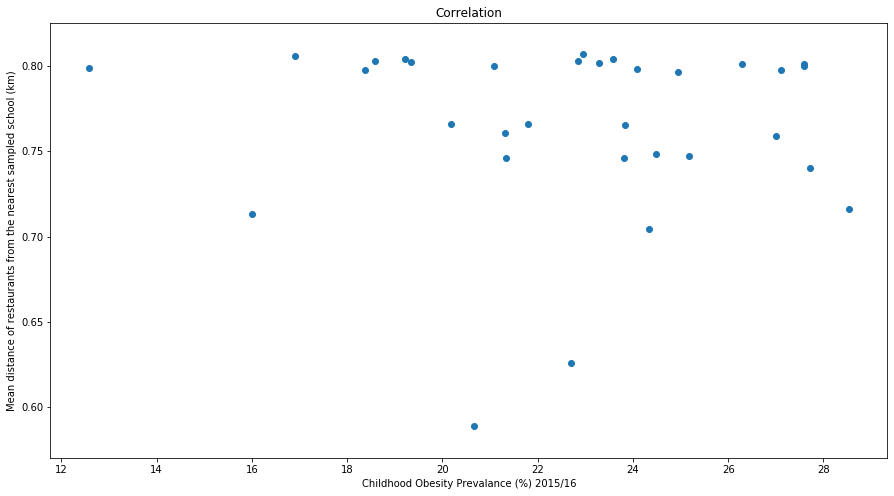

In [17]:
# A scatter plot is drawn to show the relation between the two variables.

plt.figure(figsize=(15,8))
plt.scatter(x,y)
plt.xlabel("Childhood Obesity Prevalance (%) 2015/16")
plt.ylabel("Mean distance of restaurants from the nearest sampled school (km)")
plt.title("Correlation")

stats.pearsonr(x,y)      # Pearson's correlation coefficient

(0.06282560432169965, 0.732656996763499)

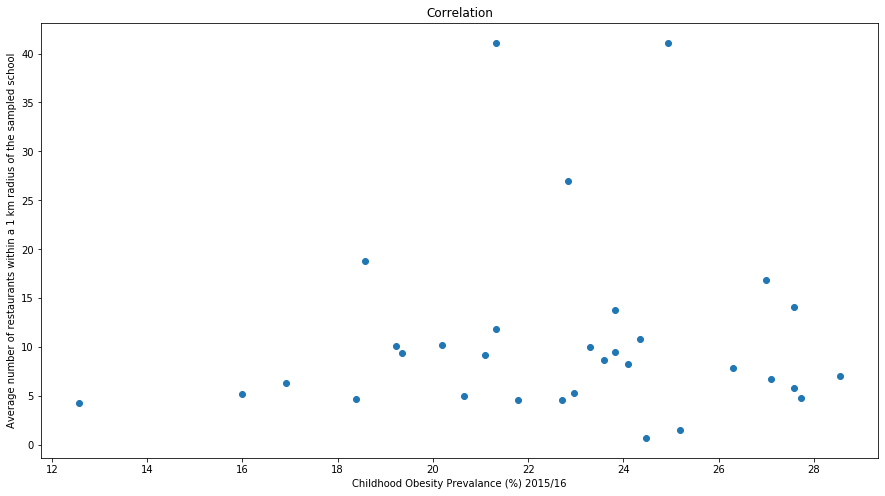

In [18]:
plt.figure(figsize=(15,8))
plt.scatter(x,z)
plt.xlabel("Childhood Obesity Prevalance (%) 2015/16")
plt.ylabel("Average number of restaurants within a 1 km radius of the sampled school")
plt.title("Correlation")

stats.pearsonr(x,z)   # Pearson's correlation coefficient

We next want to display all the search results on a map of London. For that, we first find out the coordinates of London.

In [19]:
geolocator = Nominatim(user_agent="test-user")
location = geolocator.geocode("London, Great Britain")
lat_lon = location.latitude
long_lon = location.longitude
lat_lon, long_lon

map_london = folium.Map(location=[lat_lon, long_lon], zoom_start=10) # We use folium to develop the map.

Next, we use three embedded for loops to cycle through each borough, each school, and each fast food restaurant and be displayed on the London map. 


In [27]:
CLIENT_ID = 'FVVCW3X51XNUA3KIGWF5RDKHGL5PWIO1CLXO1ALHDYKEX14D' # Foursquare ID
CLIENT_SECRET = '0UHETLYLXBFQJ2HQRN3Y1XXVTKIIH5J1UTXANHEICWT2EFB2' # Foursquare Secret
VERSION = '20200617' # Foursquare API version
LIMIT1 = 10 # limit for the number of schools returned
radius1 = 2000 # radius for the schools 
LIMIT2 = 50 # limit for the number of fast food restaurants returned
radius2 = 1000 # radius for the fast food restaurants
categoryid_school='4bf58dd8d48988d13b941735'     # search category ID for schools
categoryid_ffr= '4bf58dd8d48988d16e941735'       # search category ID for fast food restaurants

# The code inside the loops is exactly the same as previously used in the function. 

for i in obesity_data.index:
    
    url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    obesity_data.loc[i][3], 
    obesity_data.loc[i][4], 
    radius1, 
    LIMIT1, categoryid_school)
    
    results = requests.get(url).json()
    
    schools = results['response']['venues']
    nearby_schools = json_normalize(schools) 
    
    
    for j in nearby_schools.index:
            nearby_schools.iloc[j]['location.lat']
            nearby_schools.iloc[j]['location.lng']

            url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            nearby_schools.iloc[j]['location.lat'], 
            nearby_schools.iloc[j]['location.lng'], 
            radius2, 
            LIMIT2, categoryid_ffr)
            
            results_ffr = requests.get(url).json()
            ffr = results_ffr['response']['venues']

            nearby_ffr = json_normalize(ffr) 
            
                        
            for k in nearby_ffr.index:

                    nearby_ffr.iloc[k]['location.lat']
                    nearby_ffr.iloc[k]['location.lng']

                    coords_1 = (nearby_ffr.iloc[k]['location.lat'], nearby_ffr.iloc[k]['location.lng'])
                    coords_2 = (nearby_schools.iloc[j]['location.lat'], nearby_schools.iloc[j]['location.lng'])
                                      
                    # We use Circle Marker to mark the respective points and label them accordingly.
                    
                    label_schools = '{}'.format(nearby_schools.iloc[j]['name'])
                    label_schools = folium.Popup(label_schools, parse_html=True)
                    folium.CircleMarker(
                        [nearby_schools.iloc[j]['location.lat'], nearby_schools.iloc[j]['location.lng']],
                        radius=5,
                        popup=label_schools,
                        color='red', # All schools to be marked with a red circle
                        fill=True,
                        fill_color='#cc3131',
                        fill_opacity=0.7,
                        parse_html=False).add_to(map_london) 

                    label_ffr = '{}'.format(nearby_ffr.iloc[k]['name'])
                    label_ffr = folium.Popup(label_ffr, parse_html=True)
                    folium.CircleMarker(
                        [nearby_ffr.iloc[k]['location.lat'], nearby_ffr.iloc[k]['location.lng']],
                        radius=5,
                        popup=label_ffr,
                        color='blue', # All fast food restaurants to be marked with a blue circle
                        fill=True,
                        fill_color='#3186cc',
                        fill_opacity=0.7,
                        parse_html=False).add_to(map_london) 

             
                    
map_london

We also mark the boroughs (via the respective coordinates of each borough council) with those that have childhood obesity rates greater than the global average (marked in red) and those that have childhood obesity rates lower than the global average (marked in blue). 

In [25]:
map_london2 = folium.Map(location=[lat_lon, long_lon], zoom_start=10)


for i in obesity_data.index:
    if obesity_data.iloc[i][1]>18:

            label_boroughs = '{}, {:.2f} %'.format(obesity_data.iloc[i][0], obesity_data.iloc[i][1])
            #label_boroughs = folium.Popup(label_boroughs, parse_html=True) 
           
            folium.CircleMarker(
            [obesity_data.iloc[i]['Latitude'], obesity_data.iloc[i]['Longitude']],
            radius=5,
            popup=label_boroughs,
            color='red',
            fill=True,
            fill_color='#cc3131',
            fill_opacity=0.7, 
            parse_html=True).add_to(map_london2)
            
    else:
        
            label_boroughs = '{}, {:.2f} %'.format(obesity_data.iloc[i][0], obesity_data.iloc[i][1])
            #label_boroughs = folium.Popup(label_boroughs, parse_html=True) 
           
            folium.CircleMarker(
            [obesity_data.iloc[i]['Latitude'], obesity_data.iloc[i]['Longitude']],
            radius=5,
            popup=label_boroughs,
            color='blue',
            fill=True,
            fill_color='#3186cc',
            fill_opacity=0.7, 
            parse_html=True).add_to(map_london2)

map_london2

Thank you for going through this notebook. 